<a href="https://colab.research.google.com/github/ximena01cn/FIScomp/blob/main/Nahuatl.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Paqueterías generales (iniciar antes de los demás)

In [ ]:
#Paquetería para leer audios y obtener espectrogramas
import librosa
#paquetería para grraficar espectrogramas
import matplotlib.pyplot as plt
#Instalación de transformers
!pip install transformers
#Torch es necesario pues de aquí se extraen los vectores y matrices que usa transformers
import torch
#la pipeline nos ayuda definir la tarea que queremos hacer con transformers
from transformers import pipeline

#Dejamos por default que colab use el entorno de cuda, de no encontrarlo, entonces usa el CPU
device = "cuda:0" if torch.cuda.is_available() else "cpu"

#La pipeline la definimos para realizar reconocimiento automático de audio, usamos el modelo whisper-medium
pipe = pipeline(
    "automatic-speech-recognition", model="openai/whisper-medium", device=device
)
#instalación de allosaurus
!pip install allosaurus
#importamos el transcriptor
from allosaurus.app import read_recognizer
#impoortamos el modelo por default ('detecta los fonemas de varias lenguas')
model = read_recognizer()

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/1.99k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/3.06G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/3.75k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/283k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/836k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.48M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/494k [00:00<?, ?B/s]

normalizer.json:   0%|          | 0.00/52.7k [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/34.6k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/2.19k [00:00<?, ?B/s]

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


preprocessor_config.json:   0%|          | 0.00/185k [00:00<?, ?B/s]

  Preparing metadata (setup.py) ... done
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl.metadata (1.8 kB)
  Using cached nv

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## FUNCIÓN PARA LA SEGMENTACIÓN DE AUDIO


In [ ]:
import librosa
import soundfile as sf
import os

def segment_audio(nombre_archivo, start_second, end_second, output_index):
    """
    Segment an audio file into smaller duration audio segments.

    Parameters:
        input_file (str): Path to the input audio file.
        start_second (float): Starting second of the segment.
        end_second (float): Ending second of the segment.
        output_index (int): Index associated with the output file name.

    Returns:
        None
    """
    input_file = '/content/drive/MyDrive/Pruebas_Nahuatl/Audios_N/Tecol_Botan_FHR321_mowih-Acanthaceae_2012-07-16-b.wav'

    # Load the audio file
    audio, sr = librosa.load(input_file, sr=None)

    # Convert time to frame indices
    start_frame = int(start_second * sr)
    end_frame = int(end_second * sr)

    # Ensure the end frame doesn't exceed the length of the audio
    if end_frame > len(audio):
        end_frame = len(audio)

    # Extract the segment
    segment = audio[start_frame:end_frame]

    ruta_destino="/content/drive/MyDrive/Pruebas_Nahuatl/Audios cortados/" +nombre_archivo+ "_seg"

    # Create the output directory if it doesn't exist
    os.makedirs(ruta_destino, exist_ok=True)



    # Write the segment to a new audio file
    output_file = os.path.join(ruta_destino, f"seg_{output_index}" + nombre_archivo + ".wav")
    sf.write(output_file, segment, sr)


audio:[ 4.5012624e-04  3.3812248e-04  9.1114809e-05 ...  1.8203604e-06
 -1.8547205e-05 -1.9137360e-06],
sampling_rate:22050


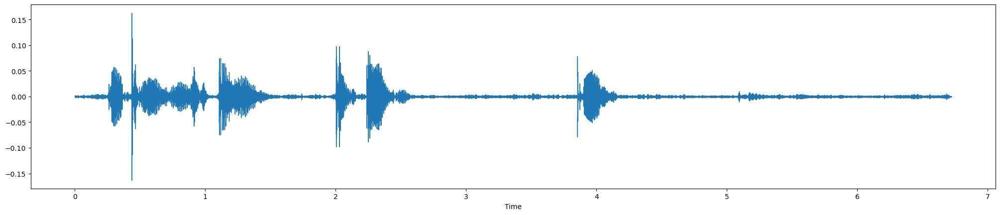

In [ ]:
segment_audio('Tecol_Botan_mowih' , 370 , 387,  17.2)

a='/content/drive/MyDrive/Pruebas_Nahuatl/Audios cortados/Tecol_Botan_mowih_seg/seg_17.2Tecol_Botan_mowih.wav'
#lectura del audio y obtención de las intensidades y sampling rate del audio
y,sr=librosa.load(a)
#imprimimos las intensidades y el sampling rate
print(f'audio:{y},\nsampling_rate:{sr}')

#graficamos el espectrograma

plt.figure().set_figwidth(25)
librosa.display.waveshow(y, sr=sr)


from IPython.display import Audio

Audio(y, rate=sr)

In [ ]:
pipe(
    y.copy(),
    max_new_tokens=256,
    generate_kwargs={"task": "transcribe"},
    chunk_length_s=30,
    batch_size=10,
    return_timestamps=True
)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


{'text': ' Barte man, ma sotin, ta pulna. Kaya man.',
 'chunks': [{'timestamp': (0.0, 4.0),
   'text': ' Barte man, ma sotin, ta pulna.'},
  {'timestamp': (5.0, 6.0), 'text': ' Kaya man.'}]}

# FUNCIÓN QUE MECANIZA EL PROCESO DE TRANSCRIPCIÓN C:

In [ ]:
### MANDAR TRANSCRIPCIONES A CSV

def procesar_todos_audios_CSV(directorio_entrada, variable_prefix, output_csv, start_index=0, end_index=None):
    # Obtener la lista de archivos .wav en el directorio de entrada
    archivos = [f for f in os.listdir(directorio_entrada) if f.endswith('.wav')]

    # Ajustar el end_index si es None o mayor que la longitud de archivos
    if end_index is None or end_index > len(archivos):
        end_index = len(archivos)

    # Lista para almacenar las transcripciones
    transcripciones = []

    # Iterar sobre el rango especificado de archivos de audio
    for i in range(start_index, end_index):
        archivo = archivos[i]
        nombre_archivo = os.path.splitext(archivo)[0]
        input_file = os.path.join(directorio_entrada, archivo)

        # Cargar el archivo de audio
        y, sr = librosa.load(input_file)

        # Realizar la transcripción usando el pipeline
        try:
            result = pipe(
                y.copy(),
                max_new_tokens=256,
                generate_kwargs={"task": "transcribe"},
                chunk_length_s=30,
                batch_size=10,
                return_timestamps=True
            )

            # Extraer solo el texto de la transcripción
            transcripcion = result['text']

        except Exception as e:
            transcripcion = f"Error durante la transcripción: {e}"

        # Añadir la transcripción a la lista
        transcripciones.append([archivo, transcripcion])

        # Imprimir el resultado de la transcripción
        print(f"Transcripción para {archivo}:\n", transcripcion)

    # Añadir la extensión .csv al nombre del archivo si no está presente
    if not output_csv.endswith('.csv'):
        output_csv += '.csv'

    # Guardar las transcripciones en un archivo CSV
    output_file = os.path.join("/content/drive/MyDrive/Whisperr", output_csv)
    # Verificar si el archivo CSV ya existe
    if os.path.exists(output_file):
        # Abrir el archivo CSV en modo de escritura y agregar las nuevas transcripciones
        with open(output_file, mode='a', newline='', encoding='utf-8') as file:
            writer = csv.writer(file)
            writer.writerows(transcripciones)  # Escribir transcripciones
    else:
        # Crear un nuevo archivo CSV y guardar las transcripciones
        with open(output_file, mode='w', newline='', encoding='utf-8') as file:
            writer = csv.writer(file)
            writer.writerow(["Archivo", "Transcripción"])  # Escribir encabezado
            writer.writerows(transcripciones)  # Escribir transcripciones

    print(f'Transcripciones guardadas en {output_file}')

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
from IPython.display import Audio
from transformers import pipeline
import os
import csv


In [ ]:
## PROCESAR TODOS LOS AUDIOS A LA VEZ Y QUE SE MUESTRE EL AUDIO Y LA IMAGEN CON LA TRANSCRIPCIÓN

def procesar_todos_audios(directorio_entrada, variable_prefix, start_index=0, end_index=None):


    # Obtener la lista de archivos .wav en el directorio de entrada
    archivos = [f for f in os.listdir(directorio_entrada) if f.endswith('.wav')]

    # Ajustar el end_index si es None o mayor que la longitud de archivos
    if end_index is None or end_index > len(archivos):
        end_index = len(archivos)

    # Iterar sobre el rango especificado de archivos de audio
    for i in range(start_index, end_index):
        archivo = archivos[i]
        nombre_archivo = os.path.splitext(archivo)[0]
        input_file = os.path.join(directorio_entrada, archivo)

        # Cargar el archivo de audio
        y, sr = librosa.load(input_file)

        # Definir las variables dinámicamente usando el prefijo y el contador
        y_var_name = f'y_{variable_prefix}_{i:03d}'
        sr_var_name = f'sr_{variable_prefix}_{i:03d}'

        # Asignar los valores a las variables
        globals()[y_var_name] = y
        globals()[sr_var_name] = sr

        # Imprimir las intensidades y la tasa de muestreo
        print(f'audio: {globals()[y_var_name]},\nsampling_rate: {globals()[sr_var_name]}')

        # Graficar el espectrograma
        plt.figure().set_figwidth(25)
        librosa.display.waveshow(globals()[y_var_name], sr=globals()[sr_var_name])
        plt.show()

        # Reproducir el audio
        display(Audio(globals()[y_var_name], rate=globals()[sr_var_name]))

        # Realizar la transcripción usando el pipeline
        result = pipe(
            globals()[y_var_name].copy(),
            max_new_tokens=256,
            generate_kwargs={"task": "transcribe"},
            chunk_length_s=30,
            batch_size=10,
            return_timestamps=True
        )

        # Imprimir el resultado de la transcripción
        print(f"Transcripción para {archivo}:\n", result)



# TRANSCRIPCIÓN LITERAL

### TECOL BOTAN

In [ ]:

directorio_entrada = "/content/drive/MyDrive/Pruebas_Nahuatl/Audios cortados/Tecol_Botan_mowih_seg"


audio: [-9.0444473e-06 -2.4179388e-05 -7.1411796e-07 ...  7.1259920e-04
  4.5835396e-04  6.6157838e-04],
sampling_rate: 22050


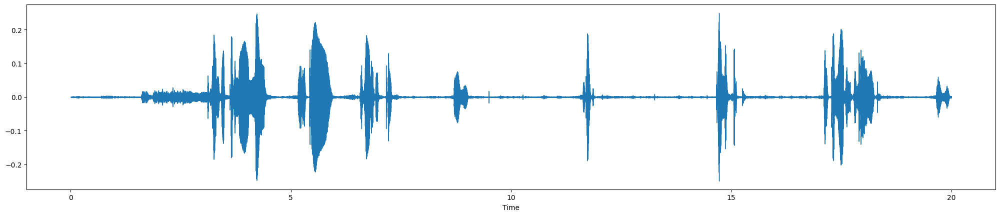

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_0Tecol_Botan_mowih.wav:
 {'text': ' ეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეე', 'chunks': [{'timestamp': (0.0, None), 'text': ' ეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეეე'}]}
audio: [-9.0444473e-06 -2.4179388e-05 -7.1411796e-07 ...  1.3981527e-04
  3.4511369e-04  3.2386632e-04],
sampling_rate: 22050


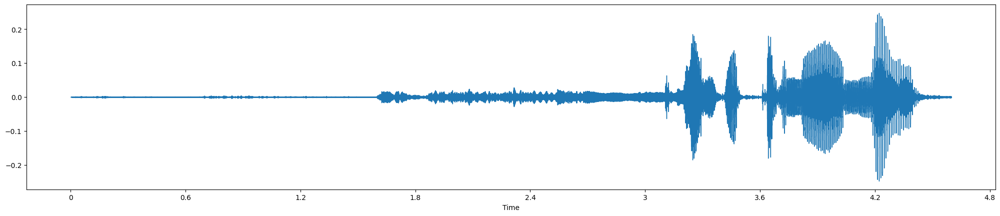

Transcripción para seg_0.1Tecol_Botan_mowih.wav:
 {'text': ' Тки шмат търне моли.', 'chunks': [{'timestamp': (0.0, 6.28), 'text': ' Тки шмат търне моли.'}]}
audio: [-3.6810881e-05 -3.2822398e-04 -3.8898119e-04 ...  1.1459019e-03
  5.8834750e-04  0.0000000e+00],
sampling_rate: 22050


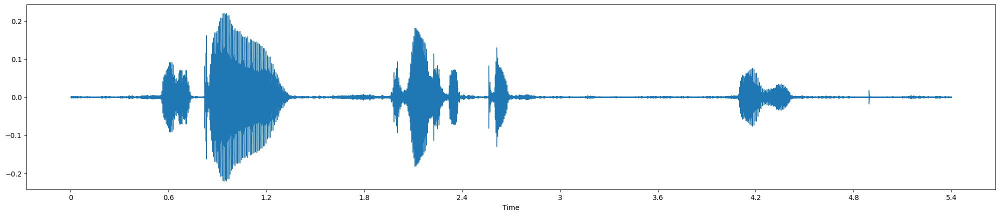

Transcripción para seg_0.2Tecol_Botan_mowih.wav:
 {'text': ' Es ist......nicht mehr geschmattet. Aber...', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' Es ist...'}, {'timestamp': (2.0, 4.0), 'text': '...nicht mehr geschmattet.'}, {'timestamp': (5.0, 7.0), 'text': ' Aber...'}]}
audio: [0.00064283 0.00096595 0.00059084 ... 0.00139811 0.00099508 0.0006682 ],
sampling_rate: 22050


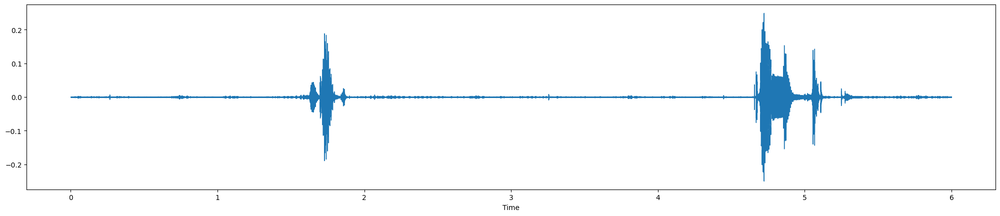

Transcripción para seg_0.3Tecol_Botan_mowih.wav:
 {'text': ' Okay. Can you see?', 'chunks': [{'timestamp': (0.0, 6.38), 'text': ' Okay.'}, {'timestamp': (6.38, 7.08), 'text': ' Can you see?'}]}
audio: [5.5416338e-05 1.8243608e-04 6.7646103e-04 ... 7.1259926e-04 4.5835410e-04
 6.6157838e-04],
sampling_rate: 22050


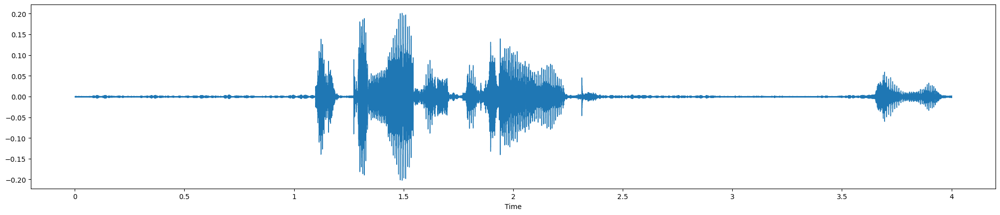

Transcripción para seg_0.4Tecol_Botan_mowih.wav:
 {'text': ' Es teimāju, viņš picaug. Hēma.', 'chunks': [{'timestamp': (0.0, 4.0), 'text': ' Es teimāju, viņš picaug.'}, {'timestamp': (4.0, 6.0), 'text': ' Hēma.'}]}
audio: [ 0.00038375  0.00089286  0.00064752 ... -0.00107227 -0.00163256
 -0.00217302],
sampling_rate: 22050


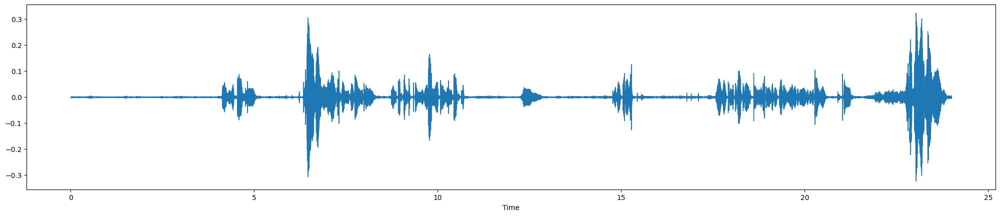

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_1Tecol_Botan_mowih.wav:
 {'text': ' ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបប', 'chunks': [{'timestamp': (None, None), 'text': ' ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបបប'}]}


In [ ]:
## audios 0 al 5

procesar_todos_audios(directorio_entrada, 'TB_N', 0, 6)

audio: [ 3.8374760e-04  8.9286407e-04  6.4751768e-04 ... -1.9084495e-05
 -3.0433628e-04 -7.5266551e-05],
sampling_rate: 22050


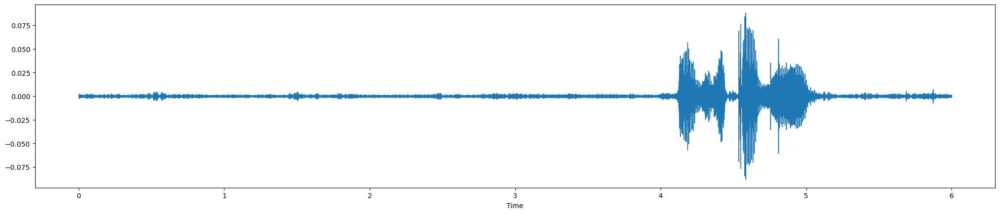

Transcripción para seg_1.1Tecol_Botan_mowih.wav:
 {'text': ' Honest to none.', 'chunks': [{'timestamp': (0.0, 7.0), 'text': ' Honest to none.'}]}
audio: [ 7.1618262e-05 -3.2947602e-04 -2.9788588e-04 ...  2.0080253e-03
  1.9490817e-03  2.3000329e-03],
sampling_rate: 22050


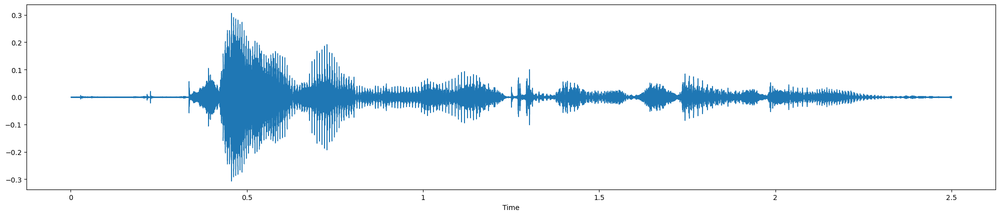

Transcripción para seg_1.2Tecol_Botan_mowih.wav:
 {'text': ' See you in the next one.', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' See you in the next one.'}]}
audio: [0.00182584 0.00284657 0.00210761 ... 0.00193202 0.00217449 0.00255742],
sampling_rate: 22050


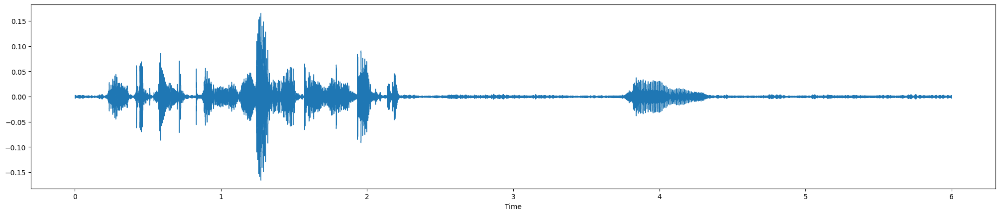

Transcripción para seg_1.3Tecol_Botan_mowih.wav:
 {'text': ' Wuskupangka kimi se mitru wadaku Juan', 'chunks': [{'timestamp': (0.0, 3.16), 'text': ' Wuskupangka kimi se mitru wadaku'}, {'timestamp': (5.16, 6.16), 'text': ' Juan'}]}
audio: [ 0.00168568  0.00321583  0.00232841 ... -0.00014352 -0.00034057
  0.00018326],
sampling_rate: 22050


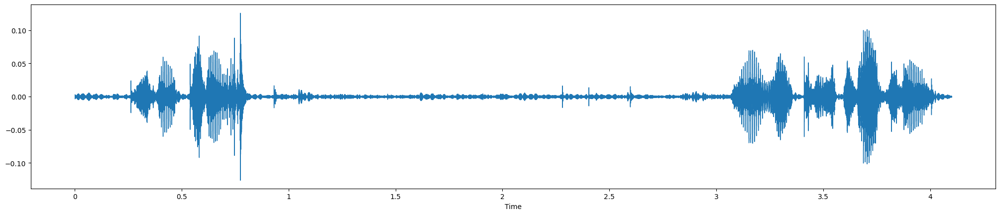

Transcripción para seg_1.4Tecol_Botan_mowih.wav:
 {'text': ' So, to... May the just to to...', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' So, to...'}, {'timestamp': (4.0, 6.0), 'text': ' May the just to to...'}]}
audio: [-1.5109713e-04 -4.4932804e-06 -2.7405759e-04 ...  5.2300282e-05
  3.9197435e-04  6.6242251e-04],
sampling_rate: 22050


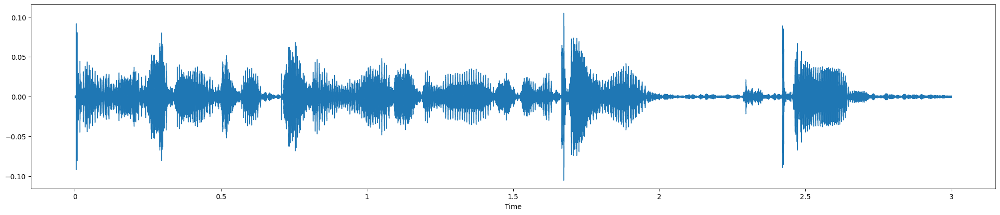

Transcripción para seg_1.5Tecol_Botan_mowih.wav:
 {'text': '手に召喚してますので、すまんごうえ。ぽけえ。', 'chunks': [{'timestamp': (0.0, 2.98), 'text': '手に召喚してますので、すまんごうえ。'}, {'timestamp': (2.98, 3.98), 'text': 'ぽけえ。'}]}


In [ ]:
## audios 5-10
procesar_todos_audios(directorio_entrada, 'MTB_N', 6, 11)

audio: [ 2.2715489e-04 -3.1949210e-04  8.5871157e-05 ... -1.0722678e-03
 -1.6325605e-03 -2.1730200e-03],
sampling_rate: 22050


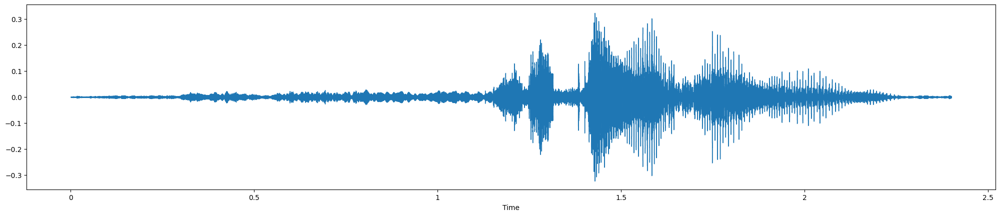

Transcripción para seg_1.6Tecol_Botan_mowih.wav:
 {'text': ' se te va el amor', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' se te va el amor'}]}
audio: [-1.5202519e-03 -1.9011425e-03 -1.5536753e-03 ...  3.1827367e-04
  8.0050624e-05 -7.8437595e-05],
sampling_rate: 22050


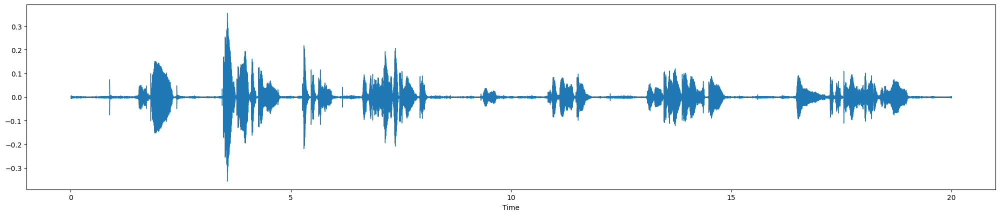

Transcripción para seg_2Tecol_Botan_mowih.wav:
 {'text': ' y que no se hagan cosas que no pueden hacer para los pueblos de la iglesia. Y que se ha servido para que los que están en el mundo puedan ver los pueblos con ellos.', 'chunks': [{'timestamp': (0.0, 12.0), 'text': ' y que no se hagan cosas que no pueden hacer para los pueblos de la iglesia.'}, {'timestamp': (12.0, 27.0), 'text': ' Y que se ha servido para que los que están en el mundo puedan ver los pueblos con ellos.'}]}
audio: [-0.00017211  0.0005827  -0.00020759 ... -0.00037999 -0.00059549
 -0.00083136],
sampling_rate: 22050


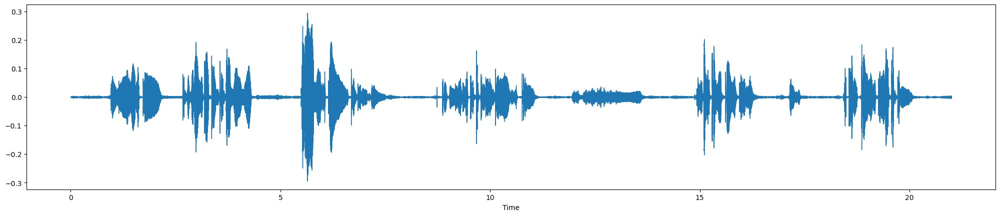

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_3Tecol_Botan_mowih.wav:
 {'text': ' იიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიი', 'chunks': [{'timestamp': (0.0, None), 'text': ' იიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიიი'}]}
audio: [-0.00017211  0.0005827  -0.00020759 ... -0.00243704 -0.00260898
 -0.00354171],
sampling_rate: 22050


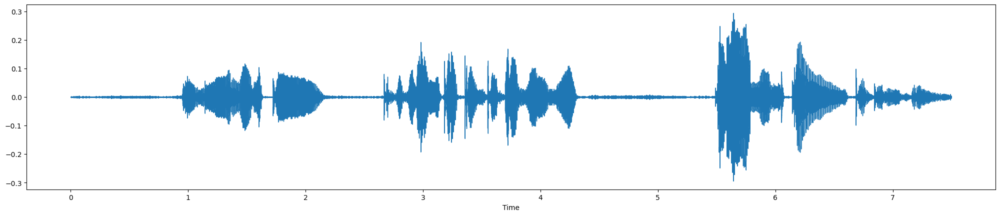

Transcripción para seg_3.1Tecol_Botan_mowih.wav:
 {'text': ' ḍo nō lēste tibitsenikokin konchallániya, parámo este kingu néxon.', 'chunks': [{'timestamp': (0.0, 10.28), 'text': ' ḍo nō lēste tibitsenikokin konchallániya, parámo este kingu néxon.'}]}
audio: [-0.00192553 -0.00323665 -0.00303679 ...  0.00037306  0.00143356
 -0.00012731],
sampling_rate: 22050


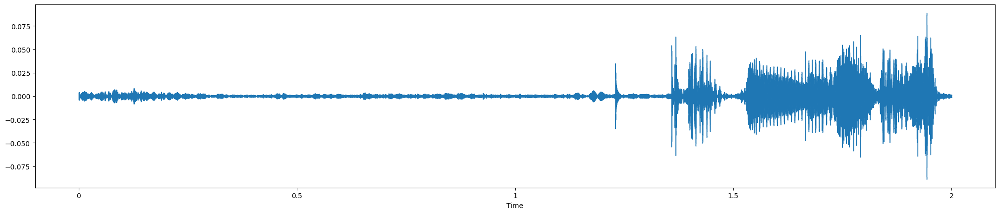

Transcripción para seg_3.2Tecol_Botan_mowih.wav:
 {'text': ' Google Assistant.', 'chunks': [{'timestamp': (0.0, 2.76), 'text': ' Google Assistant.'}]}


In [ ]:
## audios 10-15
procesar_todos_audios(directorio_entrada, 'TB_N',11, 16)

audio: [0.0006955  0.00119176 0.00010333 ... 0.00035182 0.00014792 0.00057603],
sampling_rate: 22050


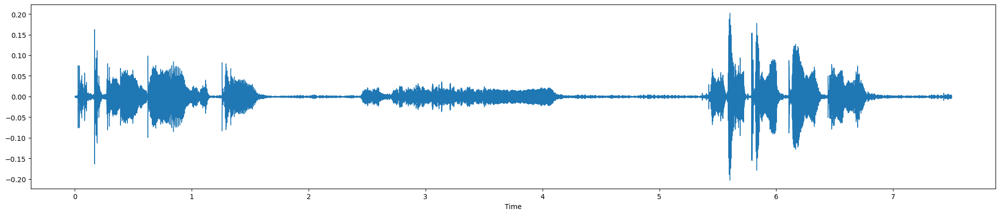

Transcripción para seg_3.3Tecol_Botan_mowih.wav:
 {'text': ' de que le ande a un este......los escolatinas de que le ha...', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' de que le ande a un este...'}, {'timestamp': (7.0, 9.0), 'text': '...los escolatinas de que le ha...'}]}
audio: [ 0.00054156  0.00077988  0.00035996 ... -0.00037999 -0.00059549
 -0.00083136],
sampling_rate: 22050


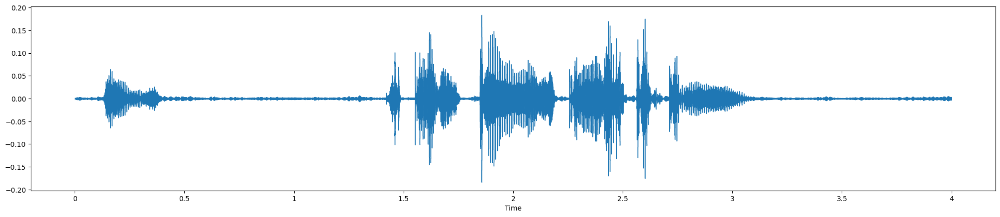

Transcripción para seg_3.4Tecol_Botan_mowih.wav:
 {'text': ' Emma, stay cool and stay good to me.', 'chunks': [{'timestamp': (0.0, 5.0), 'text': ' Emma, stay cool and stay good to me.'}]}
audio: [-0.00030806 -0.00031518  0.000784   ...  0.00044757  0.00056968
  0.00027123],
sampling_rate: 22050


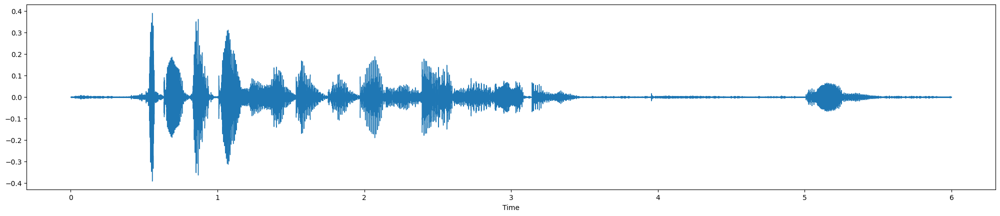

Transcripción para seg_4Tecol_Botan_mowih.wav:
 {'text': ' E que te mo parte ándese, bonte en cuanto á monga e a estón.', 'chunks': [{'timestamp': (0.0, 5.0), 'text': ' E que te mo parte ándese, bonte en cuanto á monga e a estón.'}]}
audio: [-0.00030806 -0.00031518  0.000784   ...  0.00044757  0.00056968
  0.00027123],
sampling_rate: 22050


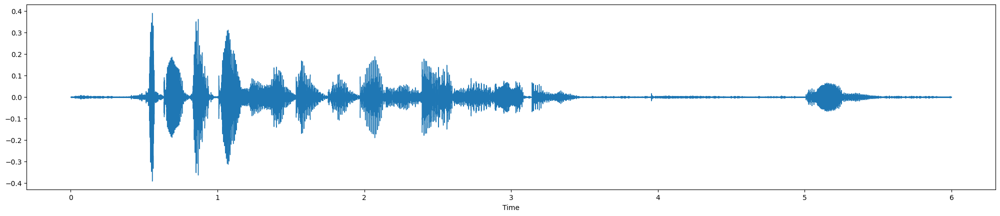

Transcripción para seg_4.1Tecol_Botan_mowih.wav:
 {'text': ' E que te mo parte ándese, bonte en cuanto á monga e a estón.', 'chunks': [{'timestamp': (0.0, 5.0), 'text': ' E que te mo parte ándese, bonte en cuanto á monga e a estón.'}]}
audio: [ 1.9020698e-04  1.2697144e-04 -2.4688956e-05 ...  2.0934481e-03
  1.5545227e-03  2.0126530e-03],
sampling_rate: 22050


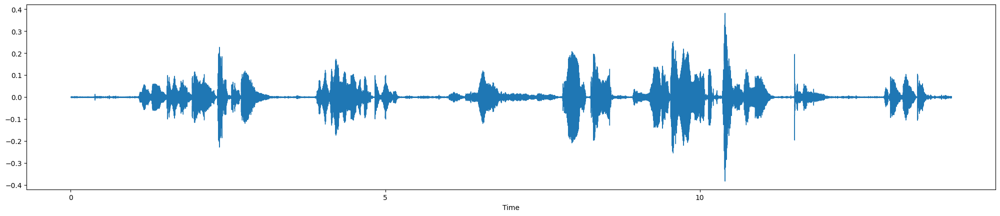

Transcripción para seg_4.2Tecol_Botan_mowih.wav:
 {'text': ' Néhi ntigilá ndéhwá npáhwtí ndéhín, néhé tzímané xtíx tukyénguk. Hulé ma, tóhé xté yó ndéhwá né tigpíá numbuné kumbanó. Nukáfé ndát.', 'chunks': [{'timestamp': (0.0, 8.0), 'text': ' Néhi ntigilá ndéhwá npáhwtí ndéhín, néhé tzímané xtíx tukyénguk.'}, {'timestamp': (8.0, 17.0), 'text': ' Hulé ma, tóhé xté yó ndéhwá né tigpíá numbuné kumbanó.'}, {'timestamp': (17.0, 19.0), 'text': ' Nukáfé ndát.'}]}


In [ ]:
## audios 15-20
procesar_todos_audios(directorio_entrada,'TB_N', 16, 21)

audio: [ 0.00107612  0.00213006  0.00195831 ... -0.00439185 -0.00430403
 -0.00426747],
sampling_rate: 22050


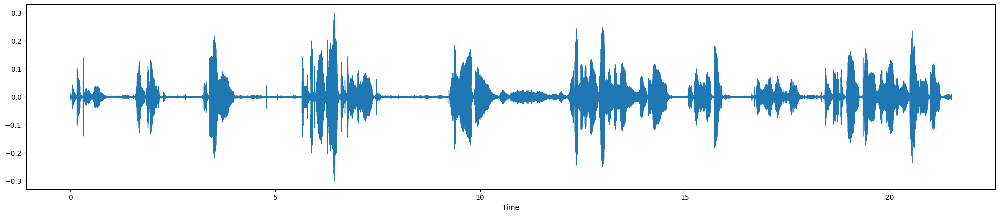

Transcripción para seg_5Tecol_Botan_mowih.wav:
 {'text': ' Tukakne hun. Chufu tseni. Morki amo ama tikma aschiwa puku nilineke. Serviro para sike molo ndiya nimbunen na tsi mokoliseta ama yunamo ne. Ama tehi piyaste menenu niyondei', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' Tukakne hun.'}, {'timestamp': (2.0, 4.0), 'text': ' Chufu tseni.'}, {'timestamp': (4.0, 6.0), 'text': ' Morki amo'}, {'timestamp': (8.0, 10.0), 'text': ' ama tikma aschiwa puku nilineke.'}, {'timestamp': (12.0, 14.0), 'text': ' Serviro para'}, {'timestamp': (16.0, 18.0), 'text': ' sike molo ndiya'}, {'timestamp': (18.0, 20.0), 'text': ' nimbunen na tsi'}, {'timestamp': (20.0, 22.0), 'text': ' mokoliseta'}, {'timestamp': (22.0, 24.0), 'text': ' ama yunamo ne.'}, {'timestamp': (24.0, 26.0), 'text': ' Ama tehi piyaste'}, {'timestamp': (26.0, 28.0), 'text': ' menenu niyondei'}]}
audio: [-0.00245059 -0.0015568   0.0015116  ... -0.00061176 -0.00023381
 -0.00087217],
sampling_rate: 22050


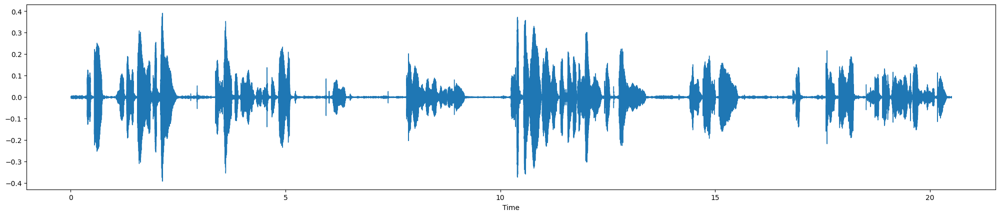

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_6Tecol_Botan_mowih.wav:
 {'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს', 'chunks': [{'timestamp': (0.0, None), 'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს'}]}
audio: [-0.00245059 -0.0015568   0.0015116  ... -0.00190875 -0.00159821
 -0.00125631],
sampling_rate: 22050


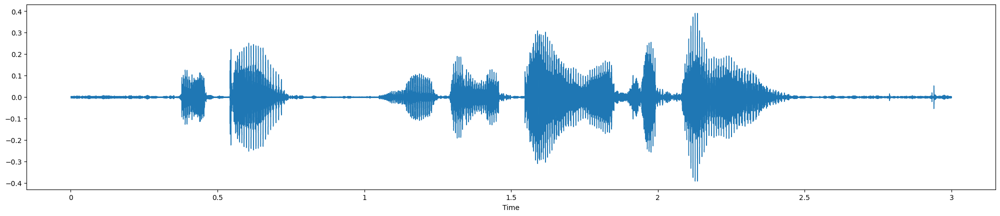

Transcripción para seg_6.1Tecol_Botan_mowih.wav:
 {'text': ' hasta una bolita de pizza para...', 'chunks': [{'timestamp': (0.0, 4.0), 'text': ' hasta una bolita de pizza para...'}]}
audio: [-1.8715113e-04 -3.6142897e-05 -6.3833583e-04 ... -1.2317542e-03
 -4.9321202e-04  1.3548627e-03],
sampling_rate: 22050


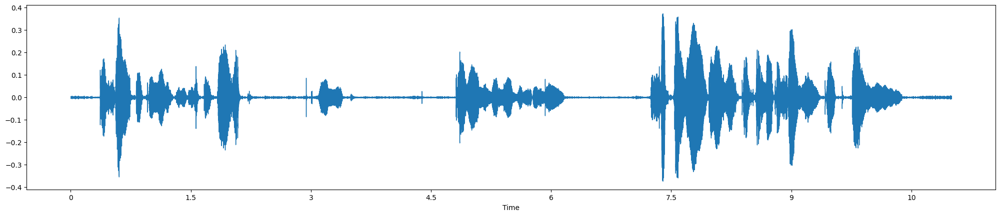

Transcripción para seg_6.2Tecol_Botan_mowih.wav:
 {'text': ' Teshawa kukulis posmi shchipawa. Ama, te wanubo nebusna li. Asatewa inti wawikia kulika sema. Tia amo.', 'chunks': [{'timestamp': (0.0, 3.0), 'text': ' Teshawa kukulis posmi shchipawa.'}, {'timestamp': (4.0, 5.0), 'text': ' Ama,'}, {'timestamp': (6.0, 8.0), 'text': ' te wanubo nebusna li.'}, {'timestamp': (9.0, 12.0), 'text': ' Asatewa inti wawikia kulika sema.'}, {'timestamp': (12.0, 14.0), 'text': ' Tia amo.'}]}
audio: [ 0.00146404  0.00178569  0.00189134 ... -0.00061176 -0.00023381
 -0.00087217],
sampling_rate: 22050


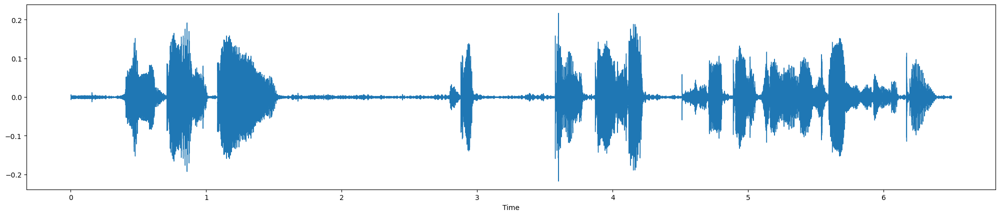

Transcripción para seg_6.3Tecol_Botan_mowih.wav:
 {'text': ' A mí me gusta que te hagas esto, que te hagas esto.', 'chunks': [{'timestamp': (0.0, 8.92), 'text': ' A mí me gusta que te hagas esto, que te hagas esto.'}]}


In [ ]:
## audios 20.25
procesar_todos_audios(directorio_entrada, 'TB_N', 21, 26)

audio: [-0.00033605 -0.00024735 -0.00077139 ... -0.0027341  -0.00279449
 -0.00426076],
sampling_rate: 22050


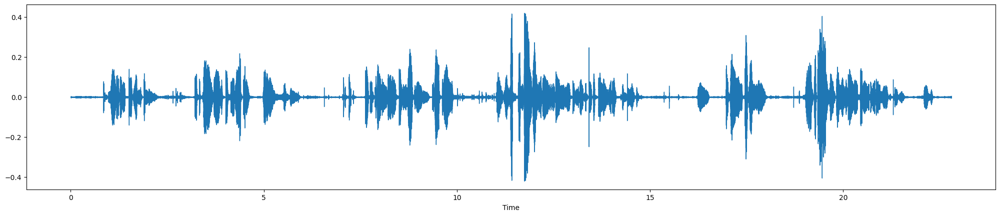

Transcripción para seg_7Tecol_Botan_mowih.wav:
 {'text': ' y más es de igual, de más es de aprovecho para el mejor. Que te haces, te seco, te seco, y en vez de pandalias, se ruido, se quité, te va a hacer pandalias. A veces hasta que me......y munticaba más coliseum por el José de Maltes.', 'chunks': [{'timestamp': (0.0, 9.0), 'text': ' y más es de igual, de más es de aprovecho para el mejor.'}, {'timestamp': (9.0, 17.0), 'text': ' Que te haces, te seco, te seco, y en vez de pandalias,'}, {'timestamp': (17.0, 25.0), 'text': ' se ruido, se quité, te va a hacer pandalias. A veces hasta que me...'}, {'timestamp': (25.0, 30.0), 'text': '...y munticaba más coliseum por el José de Maltes.'}]}
audio: [-0.00033605 -0.00024735 -0.00077139 ...  0.00100753  0.00106377
  0.0013943 ],
sampling_rate: 22050


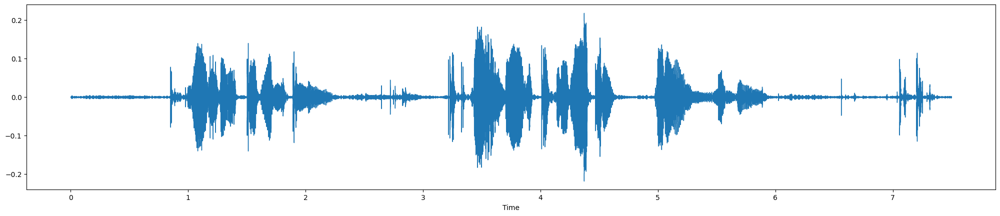

Transcripción para seg_7.1Tecol_Botan_mowih.wav:
 {'text': ' Te pases, te gualentemos, te que piaces, te aprovecho, prean, dejone.', 'chunks': [{'timestamp': (0.0, 9.0), 'text': ' Te pases, te gualentemos, te que piaces, te aprovecho, prean, dejone.'}]}
audio: [0.00083249 0.00149072 0.00176746 ... 0.00102791 0.00091006 0.00091636],
sampling_rate: 22050


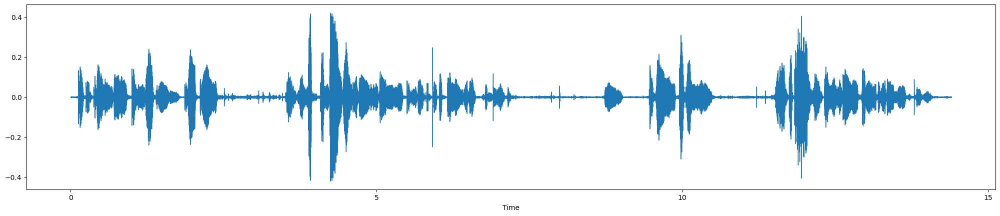

Transcripción para seg_7.2Tecol_Botan_mowih.wav:
 {'text': " ḍík'i ts'a se t'i se k'un se k'umit in b'ot pandalia se ru'yitu se ki te k'iti w'a se pandalia a b'ez'a s'ta k'i me iw'un t'i k'awa ma'a k'uli sewi apare k'o se ma'a t'i se", 'chunks': [{'timestamp': (0.0, 3.64), 'text': " ḍík'i ts'a se t'i se k'un se k'umit"}, {'timestamp': (4.84, 10.2), 'text': " in b'ot pandalia se ru'yitu se ki te k'iti w'a se pandalia"}, {'timestamp': (12.96, 14.76), 'text': " a b'ez'a s'ta k'i me"}, {'timestamp': (15.76, 19.64), 'text': " iw'un t'i k'awa ma'a k'uli sewi apare k'o se ma'a t'i se"}]}
audio: [ 5.3592247e-04  1.0676254e-03  1.1907283e-03 ...  4.5407811e-05
  9.2992697e-05 -2.9188581e-04],
sampling_rate: 22050


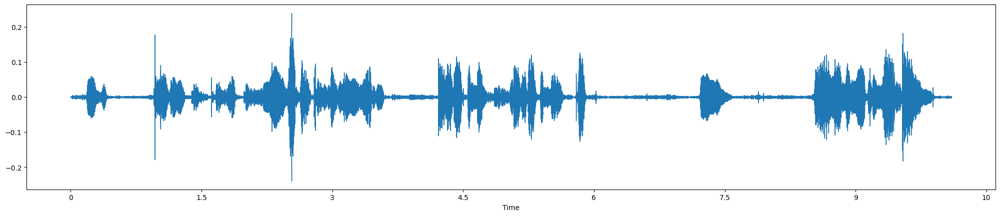

Transcripción para seg_8Tecol_Botan_mowih.wav:
 {'text': ' E nós estamos partindo de um bíblico que não é meu, que é o que nasce, o que nasce. Eu não me lembro de nada.', 'chunks': [{'timestamp': (0.0, 5.3), 'text': ' E nós estamos partindo de um bíblico que não é meu,'}, {'timestamp': (5.3, 8.3), 'text': ' que é o que nasce, o que nasce.'}, {'timestamp': (11.3, 13.8), 'text': ' Eu não me lembro de nada.'}]}
audio: [ 5.3592247e-04  1.0676254e-03  1.1907283e-03 ...  4.5407811e-05
  9.2992697e-05 -2.9188581e-04],
sampling_rate: 22050


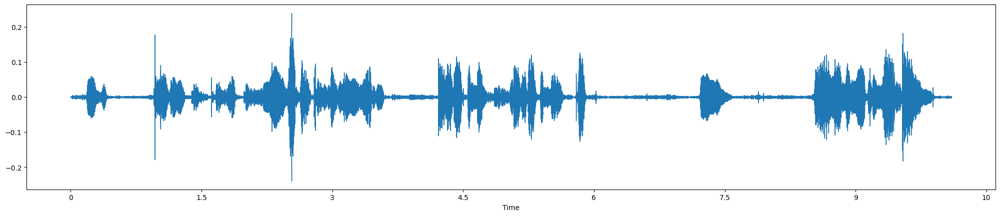

Transcripción para seg_8.1Tecol_Botan_mowih.wav:
 {'text': ' E nós estamos partindo de um bíblico que não é meu, que é o que nasce, o que nasce. Eu não me lembro de nada.', 'chunks': [{'timestamp': (0.0, 5.3), 'text': ' E nós estamos partindo de um bíblico que não é meu,'}, {'timestamp': (5.3, 8.3), 'text': ' que é o que nasce, o que nasce.'}, {'timestamp': (11.3, 13.8), 'text': ' Eu não me lembro de nada.'}]}


In [ ]:
## audios 25-30
procesar_todos_audios(directorio_entrada, 'TB_N', 26, 31)

audio: [-9.1659647e-05  4.8452854e-05  1.2033033e-04 ... -1.6924983e-03
 -1.9973838e-03 -1.2737614e-03],
sampling_rate: 22050


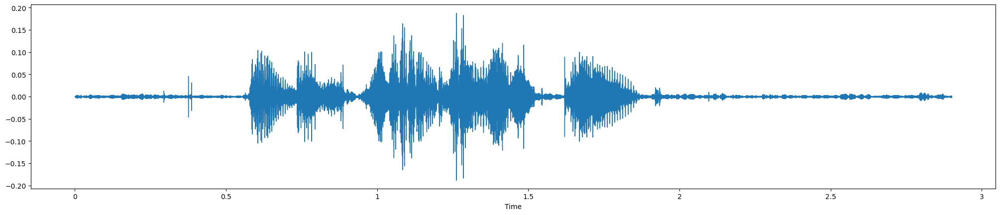

Transcripción para seg_8.2Tecol_Botan_mowih.wav:
 {'text': ' Jumku v cím, božeš ty!', 'chunks': [{'timestamp': (0.0, 4.0), 'text': ' Jumku v cím, božeš ty!'}]}
audio: [-0.00080208 -0.00188637 -0.00129908 ... -0.00108554 -0.0010889
 -0.0013589 ],
sampling_rate: 22050


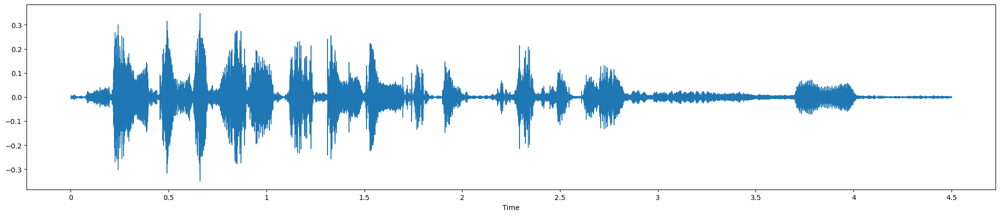

Transcripción para seg_8.3Tecol_Botan_mowih.wav:
 {'text': ' Samadeservīru par desavu grupi, pizaktsīci. Jā, nē.', 'chunks': [{'timestamp': (0.0, 4.0), 'text': ' Samadeservīru par desavu grupi, pizaktsīci.'}, {'timestamp': (5.0, 6.0), 'text': ' Jā, nē.'}]}
audio: [-0.00131818 -0.00166638 -0.00101684 ... -0.00026195 -0.00182352
 -0.00154086],
sampling_rate: 22050


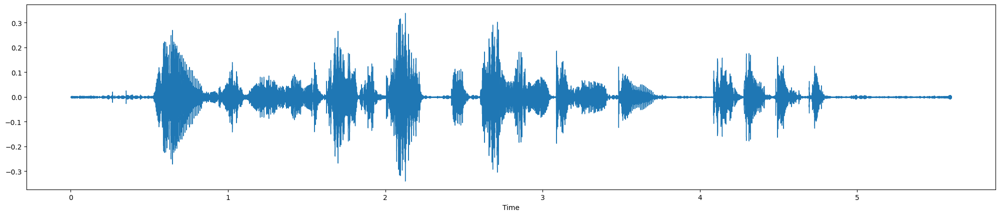

Transcripción para seg_8.4Tecol_Botan_mowih.wav:
 {'text': ' Mas se o Nenegishima e o Peholinca não tiverem um partido...', 'chunks': [{'timestamp': (0.0, 7.0), 'text': ' Mas se o Nenegishima e o Peholinca não tiverem um partido...'}]}
audio: [-0.00025121 -0.00020558  0.00152603 ... -0.00046291 -0.00067073
 -0.00068063],
sampling_rate: 22050


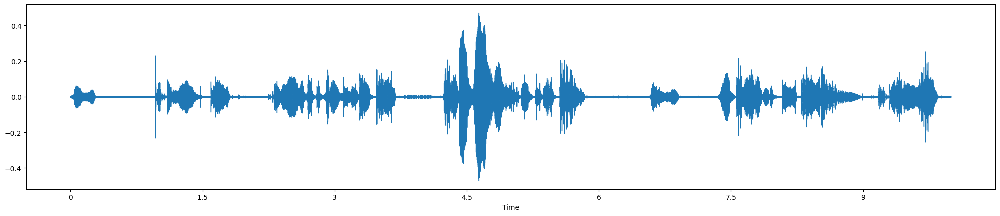

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_9Tecol_Botan_mowih.wav:
 {'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს', 'chunks': [{'timestamp': (0.0, None), 'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს'}]}
audio: [-0.00025121 -0.00020558  0.00152603 ... -0.0017353  -0.00151973
 -0.00189778],
sampling_rate: 22050


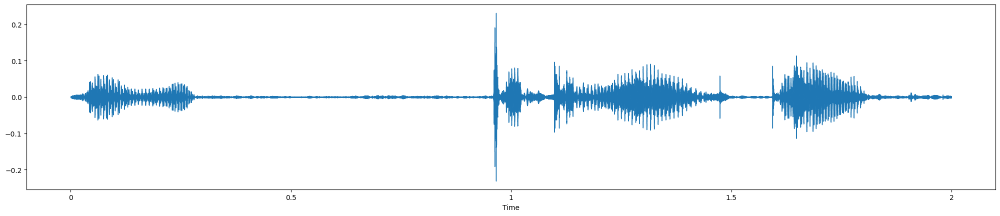

Transcripción para seg_9.1Tecol_Botan_mowih.wav:
 {'text': ' Come on, good to my dad.', 'chunks': [{'timestamp': (0.0, 2.58), 'text': ' Come on, good to my dad.'}]}


In [ ]:
## audios 30-35
procesar_todos_audios(directorio_entrada, 'TB_N', 31, 36)

audio: [-0.00158557 -0.00198776 -0.00107489 ... -0.00172818 -0.00083458
 -0.00085888],
sampling_rate: 22050


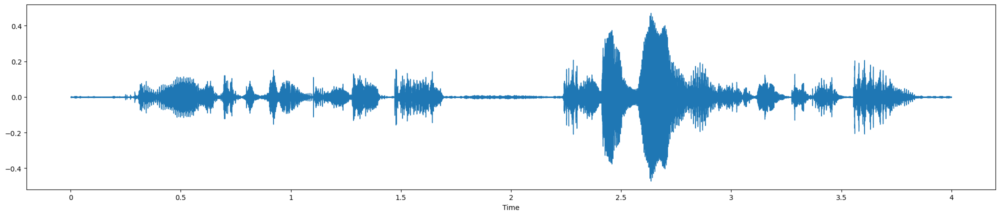

Transcripción para seg_9.2Tecol_Botan_mowih.wav:
 {'text': ' Awez tiki tzendi seitai Wasi ambi yawanochi patitai', 'chunks': [{'timestamp': (0.0, 2.48), 'text': ' Awez tiki tzendi seitai'}, {'timestamp': (2.48, 5.48), 'text': ' Wasi ambi yawanochi patitai'}]}
audio: [-0.00038537 -0.00032371 -0.00028919 ... -0.00046291 -0.00067073
 -0.00068063],
sampling_rate: 22050


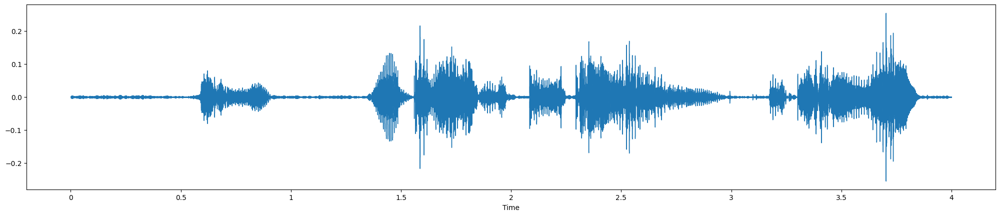

Transcripción para seg_9.3Tecol_Botan_mowih.wav:
 {'text': ' Aber, nur dir ist mir das der Junge, der schien war.', 'chunks': [{'timestamp': (0.0, 5.44), 'text': ' Aber, nur dir ist mir das der Junge, der schien war.'}]}
audio: [-5.8657071e-04 -3.0069903e-04  2.1973392e-08 ... -1.0964217e-03
 -1.3661364e-03 -1.5657531e-03],
sampling_rate: 22050


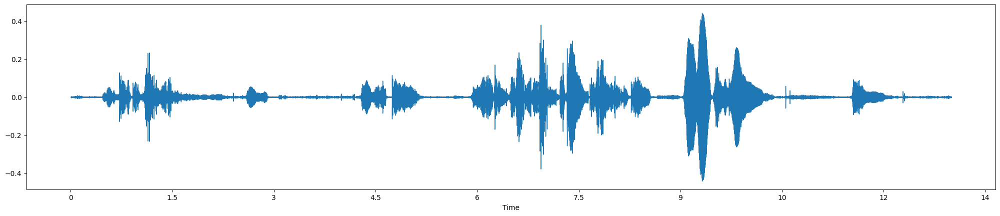

Transcripción para seg_9.4Tecol_Botan_mowih.wav:
 {'text': ' Não te estipa, ou se me......neste......posso me confundir em você, mas te cago em ti, ou assim não que......não é igual que me...', 'chunks': [{'timestamp': (0.0, 3.0), 'text': ' Não te estipa, ou se me...'}, {'timestamp': (5.0, 7.0), 'text': '...neste...'}, {'timestamp': (8.0, 12.0), 'text': '...posso me confundir em você, mas te cago em ti, ou assim não que...'}, {'timestamp': (12.0, 14.0), 'text': '...não é igual que me...'}]}
audio: [-0.00110116 -0.00124202 -0.00124963 ... -0.00491425 -0.0050199
 -0.00387515],
sampling_rate: 22050


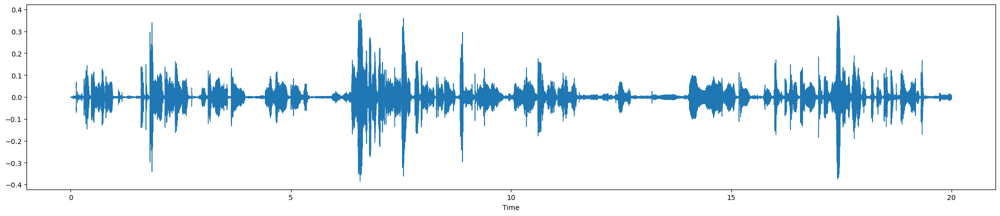

Transcripción para seg_10Tecol_Botan_mowih.wav:
 {'text': ' kwa kwa lasiwit, diktamota saliya, morki noa este muna vayo tiaumba. Yuna mguni kisi mmasaikitoka, sinukisi yuustamota sahuwan, muna vayo tiaumba seba saliya. Hema. Yuna mawisimi este pospati paratehwa. Uziyanani kishmatukwa kidikpiyama ada.', 'chunks': [{'timestamp': (0.0, 4.0), 'text': ' kwa kwa lasiwit, diktamota saliya,'}, {'timestamp': (4.0, 8.0), 'text': ' morki noa este muna vayo tiaumba.'}, {'timestamp': (8.0, 11.0), 'text': ' Yuna mguni kisi mmasaikitoka,'}, {'timestamp': (11.0, 14.0), 'text': ' sinukisi yuustamota sahuwan,'}, {'timestamp': (14.0, 17.0), 'text': ' muna vayo tiaumba seba saliya.'}, {'timestamp': (17.0, 19.0), 'text': ' Hema.'}, {'timestamp': (19.0, 23.0), 'text': ' Yuna mawisimi este pospati paratehwa.'}, {'timestamp': (23.0, 27.0), 'text': ' Uziyanani kishmatukwa kidikpiyama ada.'}]}
audio: [-0.00112081 -0.00091812  0.00024914 ...  0.00112622  0.00126476
  0.00204247],
sampling_rate: 22050


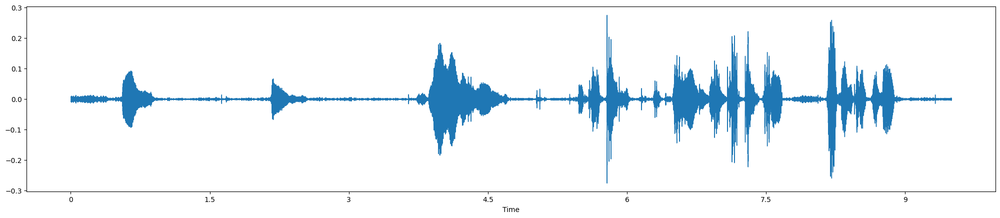

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_11Tecol_Botan_mowih.wav:
 {'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს', 'chunks': [{'timestamp': (0.0, None), 'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს'}]}


In [ ]:
## audios 35-40
procesar_todos_audios(directorio_entrada, 'TB_N', 36, 41)

audio: [-1.1208099e-03 -9.1811828e-04  2.4913982e-04 ...  2.1599721e-05
 -5.3647859e-04 -5.5190915e-04],
sampling_rate: 22050


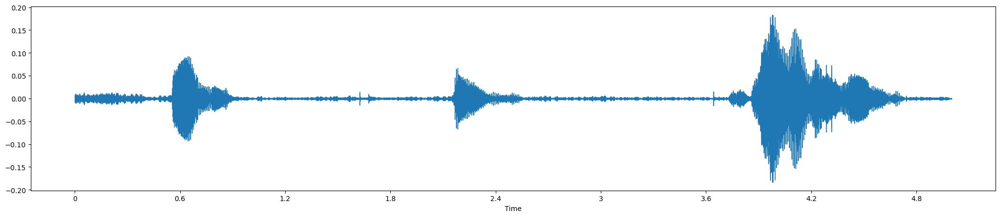

Transcripción para seg_11.1Tecol_Botan_mowih.wav:
 {'text': ' En......vän......snö och junin.', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' En...'}, {'timestamp': (2.0, 4.0), 'text': '...vän...'}, {'timestamp': (4.0, 6.0), 'text': '...snö och junin.'}]}
audio: [-0.00051266  0.00012498 -0.00014788 ... -0.00387401 -0.00310323
 -0.00470645],
sampling_rate: 22050


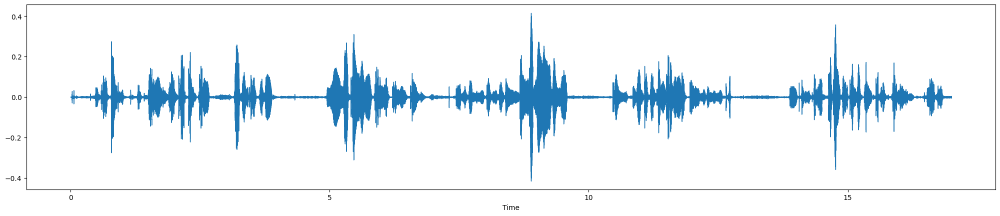

Transcripción para seg_11.2Tecol_Botan_mowih.wav:
 {'text': ' Mwadida nikpeyombla diida para bibi tsi tsi. Mii meke yuwe kisa tegitus. Mwadikini mwaka busnikin dingi na yuwe gulia. Kema nikindegi liya seru iti mwaka. Okimeki mwatu ke busni lipaati nikpeyobus nej.', 'chunks': [{'timestamp': (0.0, 6.0), 'text': ' Mwadida nikpeyombla diida para bibi tsi tsi.'}, {'timestamp': (6.0, 10.0), 'text': ' Mii meke yuwe kisa tegitus.'}, {'timestamp': (10.0, 14.0), 'text': ' Mwadikini mwaka busnikin dingi na yuwe gulia.'}, {'timestamp': (14.0, 18.0), 'text': ' Kema nikindegi liya seru iti mwaka.'}, {'timestamp': (18.0, 23.0), 'text': ' Okimeki mwatu ke busni lipaati nikpeyobus nej.'}]}
audio: [-0.00283623 -0.00415319 -0.00368698 ...  0.00149385  0.001158
  0.00110758],
sampling_rate: 22050


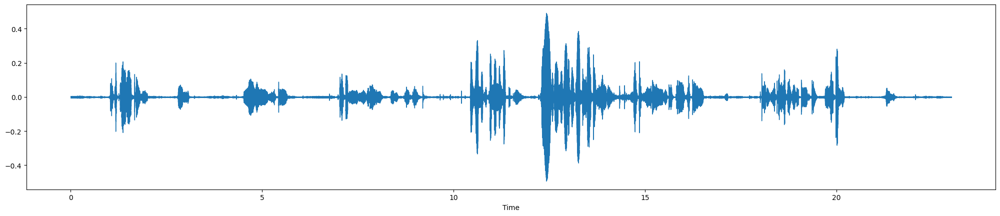

Transcripción para seg_12Tecol_Botan_mowih.wav:
 {'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს Se está más ahí, uno chupó este... Ah, matiste que... que esto va a sufrir. ¿O matá más? ¿Ah, más?', 'chunks': [{'timestamp': (26.0, 27.0), 'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს Se está más ahí, uno chupó este... Ah, matiste que... que esto va a sufrir.'}, {'timestamp': (27.0, 28.0), 'text': ' ¿O matá más?'}, {'timestamp': (29.0, 30.0), 'text': ' ¿Ah, más?'}]}
audio: [-0.00283623 -0.00415319 -0.00368698 ... -0.00086649 -0.00041876
 -0.00087621],
sampling_rate: 22050


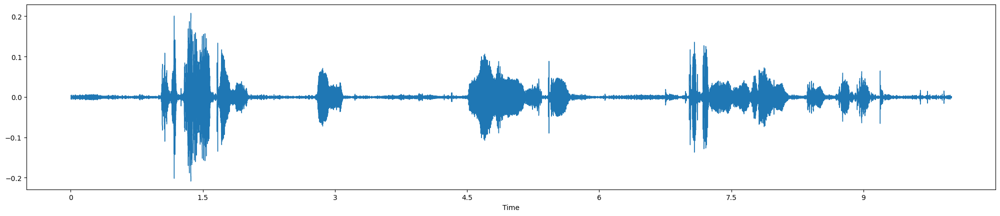

Transcripción para seg_12.1Tecol_Botan_mowih.wav:
 {'text': " E ci cuo' il metino, eh, ma ne e' vo' io, n'este, e c'at' e' mu' la nozza e' i ratito.", 'chunks': [{'timestamp': (0.0, 13.0), 'text': " E ci cuo' il metino, eh, ma ne e' vo' io, n'este, e c'at' e' mu' la nozza e' i ratito."}]}
audio: [-0.00028798 -0.00088291 -0.00119221 ...  0.00182672  0.00200666
  0.00215776],
sampling_rate: 22050


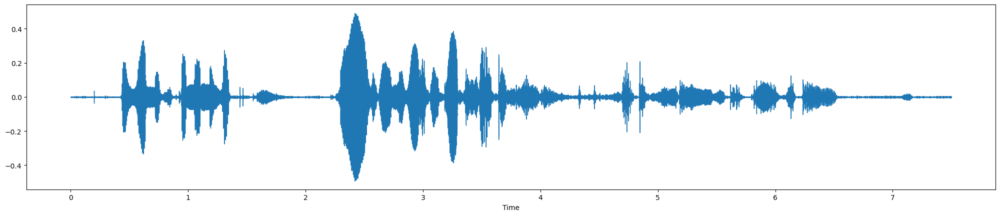

Transcripción para seg_12.2Tecol_Botan_mowih.wav:
 {'text': ' Оганът ще таменувак. Боя е снегник, вижхват и е по света маса. Света маса, юночи па сте...', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' Оганът ще таменувак.'}, {'timestamp': (3.0, 5.0), 'text': ' Боя е снегник, вижхват и е по света маса.'}, {'timestamp': (6.0, 8.0), 'text': ' Света маса, юночи па сте...'}]}


In [ ]:
## audios 40-45
procesar_todos_audios(directorio_entrada, 'TB_N', 41, 46)

audio: [0.00105762 0.0021591  0.0016688  ... 0.00149385 0.001158   0.00110758],
sampling_rate: 22050


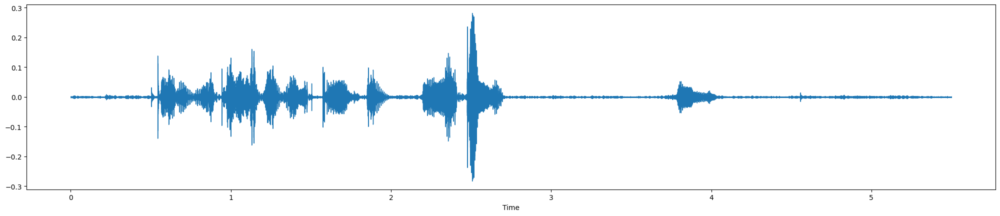

Transcripción para seg_12.3Tecol_Botan_mowih.wav:
 {'text': ' y no me pude seguir con esto. Me maté.', 'chunks': [{'timestamp': (0.0, 3.0), 'text': ' y no me pude seguir con esto.'}, {'timestamp': (3.0, 5.0), 'text': ' Me maté.'}]}
audio: [0.00059923 0.00053935 0.00062077 ... 0.00078844 0.00089127 0.00174687],
sampling_rate: 22050


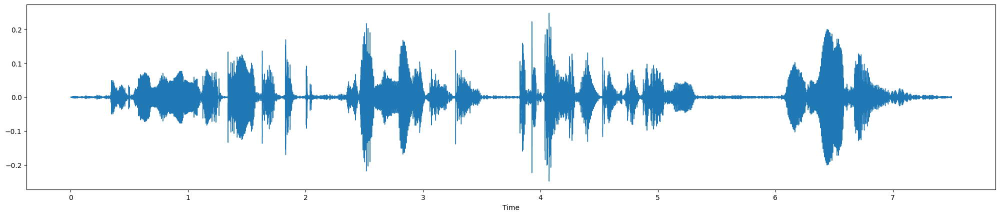

Transcripción para seg_13Tecol_Botan_mowih.wav:
 {'text': ' uz neņu oni gētāk, ka šāna lieskīv, ka tās, ka kūpcīt, no mēs mēs jau brav.', 'chunks': [{'timestamp': (0.0, 7.0), 'text': ' uz neņu oni gētāk, ka šāna lieskīv, ka tās, ka kūpcīt,'}, {'timestamp': (7.0, 10.0), 'text': ' no mēs mēs jau brav.'}]}
audio: [0.00059923 0.00053935 0.00062077 ... 0.00078844 0.00089127 0.00174687],
sampling_rate: 22050


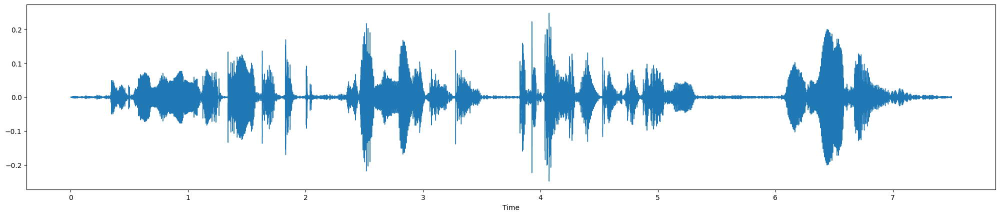

Transcripción para seg_13.1Tecol_Botan_mowih.wav:
 {'text': ' uz neņu oni gētāk, ka šāna lieskīv, ka tās, ka kūpcīt, no mēs mēs jau brav.', 'chunks': [{'timestamp': (0.0, 7.0), 'text': ' uz neņu oni gētāk, ka šāna lieskīv, ka tās, ka kūpcīt,'}, {'timestamp': (7.0, 10.0), 'text': ' no mēs mēs jau brav.'}]}
audio: [0.00108276 0.00155866 0.00104842 ... 0.0002948  0.0011019  0.00128067],
sampling_rate: 22050


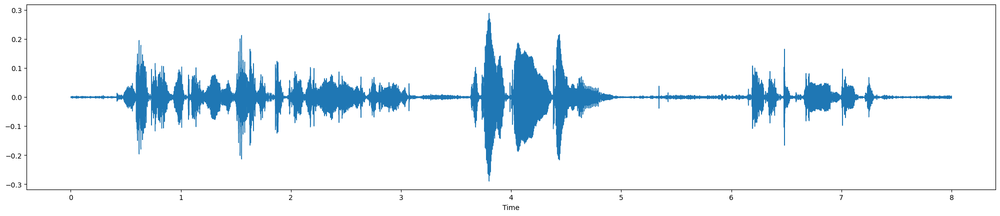

Transcripción para seg_13.2Tecol_Botan_mowih.wav:
 {'text': ' Sejidjikon enigis matikacjivayon i tzijos. Ni kwa kinkan man. Kwa tukpeasipa.', 'chunks': [{'timestamp': (0.0, 11.0), 'text': ' Sejidjikon enigis matikacjivayon i tzijos. Ni kwa kinkan man. Kwa tukpeasipa.'}]}
audio: [ 0.00078068  0.00047137 -0.0006731  ...  0.00324648  0.00248487
  0.00248518],
sampling_rate: 22050


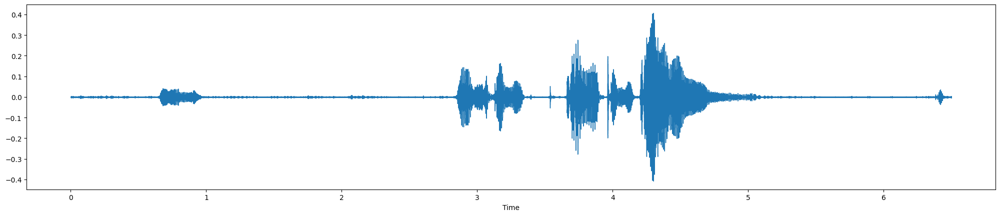

Transcripción para seg_13.3Tecol_Botan_mowih.wav:
 {'text': ' Yeah, man. Wasikine kawokunikaiin.', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' Yeah, man.'}, {'timestamp': (4.0, 7.0), 'text': ' Wasikine kawokunikaiin.'}]}


In [ ]:
## audios 45-50
procesar_todos_audios(directorio_entrada, 'TB_N', 46, 51)

audio: [ 0.00137687  0.00243295  0.00275884 ... -0.00029093 -0.00050319
 -0.00035974],
sampling_rate: 22050


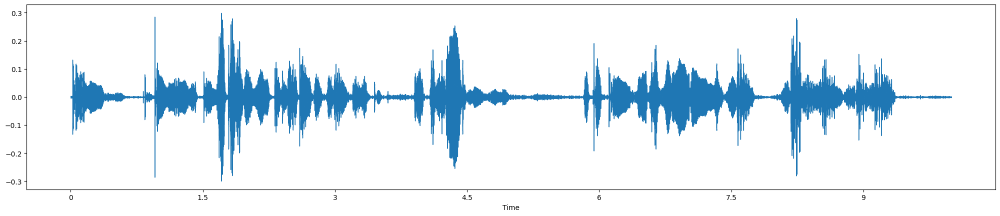

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_14Tecol_Botan_mowih.wav:
 {'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს', 'chunks': [{'timestamp': (0.0, None), 'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს'}]}
audio: [ 0.00137687  0.00243295  0.00275884 ... -0.00176337 -0.00180989
 -0.0026373 ],
sampling_rate: 22050


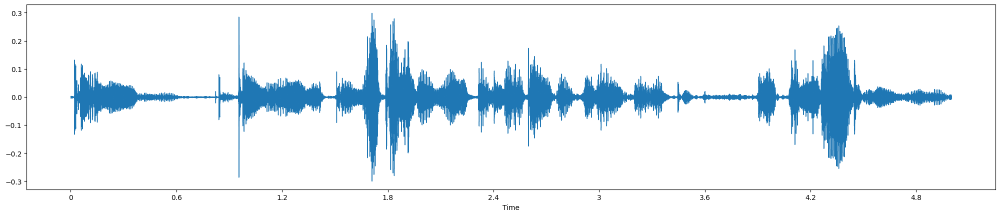

Transcripción para seg_14.1Tecol_Botan_mowih.wav:
 {'text': ' Kā jāstie, akā šī logu, zēdāt cību, ikko esi spesjārnējā.', 'chunks': [{'timestamp': (0.0, 6.8), 'text': ' Kā jāstie, akā šī logu, zēdāt cību, ikko esi spesjārnējā.'}]}
audio: [-0.0013959  -0.00216814 -0.00190755 ...  0.001734    0.00141899
  0.00216512],
sampling_rate: 22050


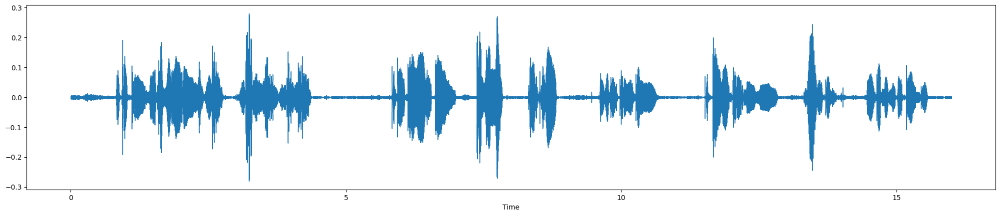

Transcripción para seg_14.2Tecol_Botan_mowih.wav:
 {'text': ' Iko ki nechi ngariwariwuli se ru ya yu se ro yu. Giji chiva iste kimona koltzi. Wangu jiji chiva ki talye deshne ni fraskus. Wangu namaka kiyanbu.', 'chunks': [{'timestamp': (0.0, 7.0), 'text': ' Iko ki nechi ngariwariwuli se ru ya yu se ro yu.'}, {'timestamp': (7.0, 12.0), 'text': ' Giji chiva iste kimona koltzi.'}, {'timestamp': (12.0, 19.0), 'text': ' Wangu jiji chiva ki talye deshne ni fraskus.'}, {'timestamp': (19.0, 22.0), 'text': ' Wangu namaka kiyanbu.'}]}
audio: [ 0.0013212   0.00250295  0.00247117 ... -0.00033407 -0.0002327
  0.00086181],
sampling_rate: 22050


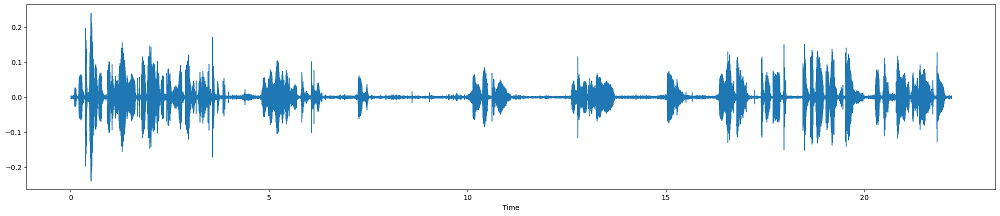

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_15Tecol_Botan_mowih.wav:
 {'text': ' ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍ Pues... Yo no me dejo de que estuvas tan fuerte para correr por campo y para especiales de...', 'chunks': [{'timestamp': (30.0, None), 'text': ' ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍḽ ḍ Pues... Yo no me dejo de que estuvas tan fuerte para correr por campo y para especiales de...'}]}
audio: [0.0013212  0.00250295 0.00247117 ... 0.00270164 0.0027272  0.00284754],
sampling_rate: 22050


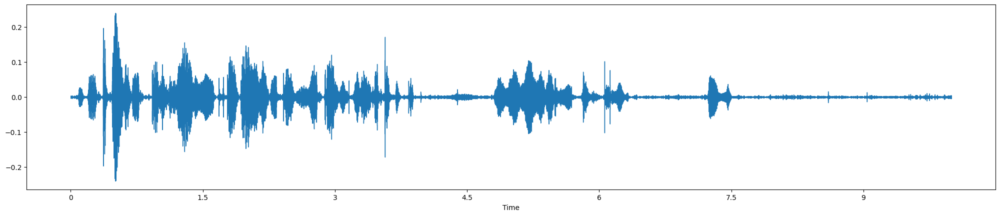

Transcripción para seg_15.1Tecol_Botan_mowih.wav:
 {'text': ' Šādi kīšmatas, vēl vāmonā, kā kā kīšmaties, nezēdāt cīkatīkīti. Neku, mūsim ir pārti, nu. Ema.', 'chunks': [{'timestamp': (0.0, 5.64), 'text': ' Šādi kīšmatas, vēl vāmonā, kā kā kīšmaties, nezēdāt cīkatīkīti.'}, {'timestamp': (6.64, 9.0), 'text': ' Neku, mūsim ir pārti, nu.'}, {'timestamp': (9.88, 10.6), 'text': ' Ema.'}]}


In [ ]:
## audios 50-55
procesar_todos_audios(directorio_entrada, 'TB_N', 51, 56)

audio: [0.00164351 0.0024525  0.00199236 ... 0.00215955 0.00227589 0.00241205],
sampling_rate: 22050


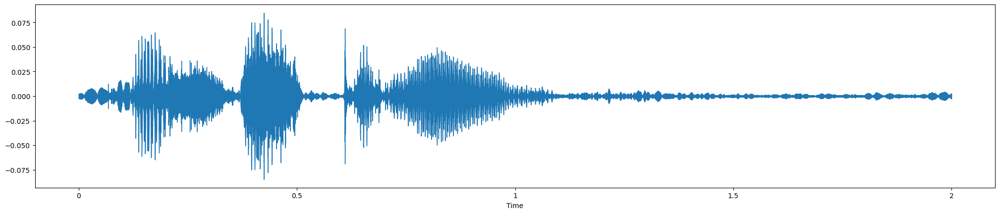

Transcripción para seg_15.2Tecol_Botan_mowih.wav:
 {'text': ' Você é que não é.', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' Você é que não é.'}]}
audio: [0.00158116 0.00236345 0.00185758 ... 0.00271134 0.00210493 0.00237368],
sampling_rate: 22050


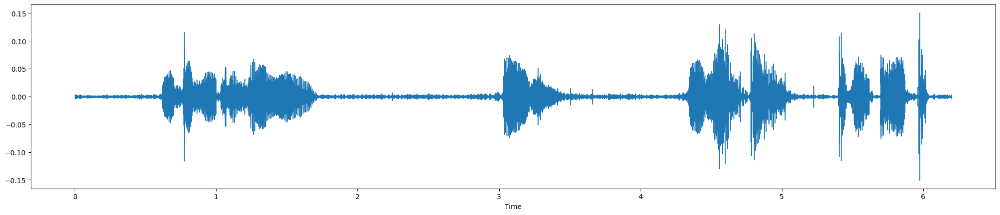

Transcripción para seg_15.3Tecol_Botan_mowih.wav:
 {'text': ' y me he hecho el yoga pues... yo no me dejo de creer todo así', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' y me he hecho el yoga'}, {'timestamp': (4.0, 5.0), 'text': ' pues...'}, {'timestamp': (6.0, 8.0), 'text': ' yo no me dejo de creer todo así'}]}
audio: [ 0.00141787  0.00237606  0.00266809 ... -0.00033407 -0.0002327
  0.00086181],
sampling_rate: 22050


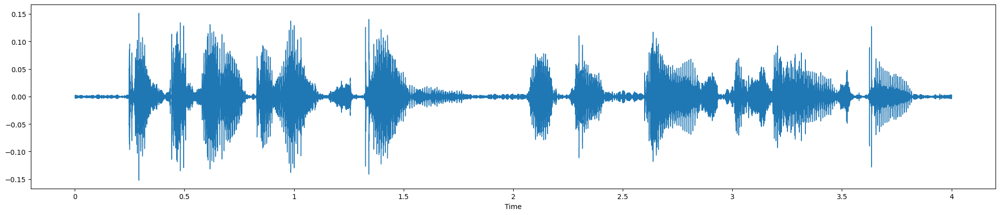

Transcripción para seg_15.4Tecol_Botan_mowih.wav:
 {'text': ' Cuate para correr por campo Y para especial este...', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' Cuate para correr por campo'}, {'timestamp': (2.0, 4.0), 'text': ' Y para especial este...'}]}
audio: [0.00085681 0.00194755 0.00209893 ... 0.00138057 0.00117236 0.00129675],
sampling_rate: 22050


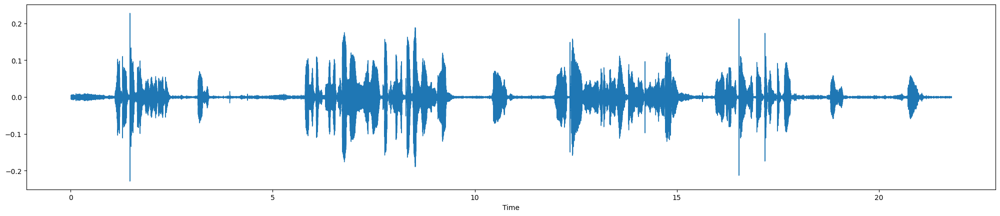

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_16Tecol_Botan_mowih.wav:
 {'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს Kursariju, nivoj crnikane ste tako ste pegoj. Hema, ste...', 'chunks': [{'timestamp': (25.0, 26.0), 'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს Kursariju, nivoj crnikane ste tako ste pegoj.'}, {'timestamp': (29.0, None), 'text': ' Hema, ste...'}]}
audio: [0.00085681 0.00194755 0.00209893 ... 0.00010331 0.00069352 0.00062787],
sampling_rate: 22050


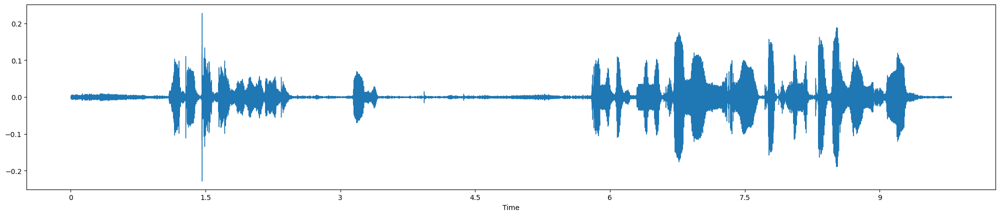

Transcripción para seg_16.1Tecol_Botan_mowih.wav:
 {'text': ' y la medicina. Bueno, pues como nochanen, y como ustedes, chile motoga, vamos a hablar.', 'chunks': [{'timestamp': (0.0, 3.0), 'text': ' y la medicina.'}, {'timestamp': (3.0, 5.0), 'text': ' Bueno, pues como nochanen,'}, {'timestamp': (5.0, 7.0), 'text': ' y como ustedes,'}, {'timestamp': (7.0, 8.0), 'text': ' chile motoga,'}, {'timestamp': (8.0, 9.0), 'text': ' vamos a hablar.'}]}


In [ ]:
## audios 55-60
procesar_todos_audios(directorio_entrada, 'TB_N', 56, 61)

audio: [ 0.00041475  0.00103166  0.00042109 ... -0.00126976 -0.00142933
 -0.00145119],
sampling_rate: 22050


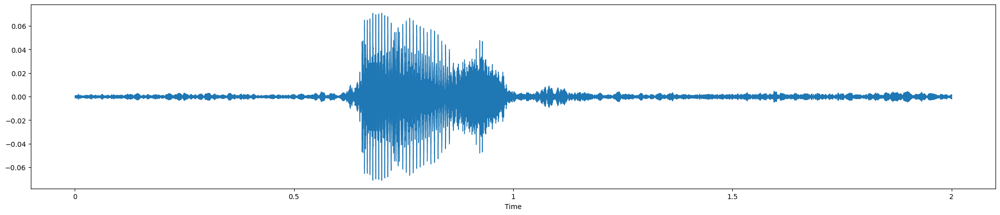

Transcripción para seg_16.2Tecol_Botan_mowih.wav:
 {'text': ' Oh, yes.', 'chunks': [{'timestamp': (0.0, 2.0), 'text': ' Oh, yes.'}]}
audio: [-0.0008206  -0.00126982 -0.00112426 ... -0.00088725 -0.00114057
 -0.00119969],
sampling_rate: 22050


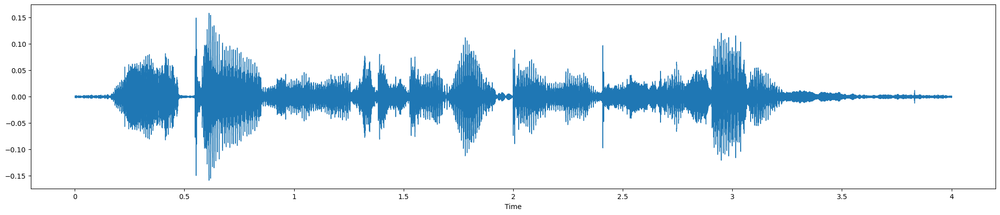

Transcripción para seg_16.3Tecol_Botan_mowih.wav:
 {'text': " n'este nemano ce fili bè rtornat f rsariu", 'chunks': [{'timestamp': (0.0, 5.2), 'text': " n'este nemano ce fili bè rtornat f rsariu"}]}
audio: [-0.00033623 -0.00094172 -0.00119482 ...  0.0005461  -0.00010555
 -0.0004547 ],
sampling_rate: 22050


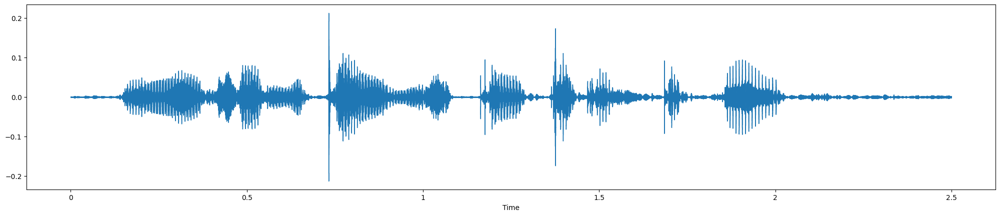

Transcripción para seg_16.4Tecol_Botan_mowih.wav:
 {'text': ' Нивој царникане сте тако сте пеју.', 'chunks': [{'timestamp': (0.0, 3.0), 'text': ' Нивој царникане сте тако сте пеју.'}]}
audio: [-0.00126224 -0.00199282 -0.00200857 ...  0.00138057  0.00117236
  0.00129675],
sampling_rate: 22050


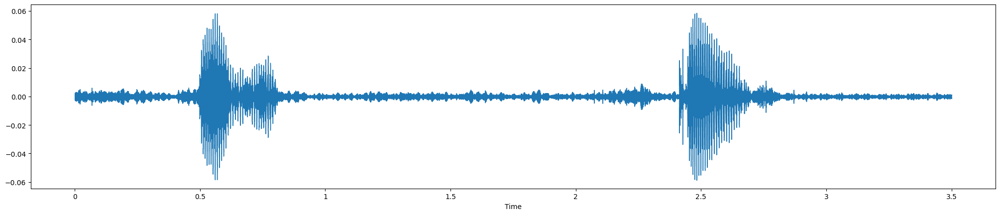

Transcripción para seg_16.5Tecol_Botan_mowih.wav:
 {'text': " I'm......stay...", 'chunks': [{'timestamp': (0.0, 2.0), 'text': " I'm..."}, {'timestamp': (2.0, 4.0), 'text': '...stay...'}]}
audio: [ 1.0682086e-03  1.1788249e-03  1.2381022e-03 ...  1.8203671e-06
 -1.8547513e-05 -1.9139047e-06],
sampling_rate: 22050


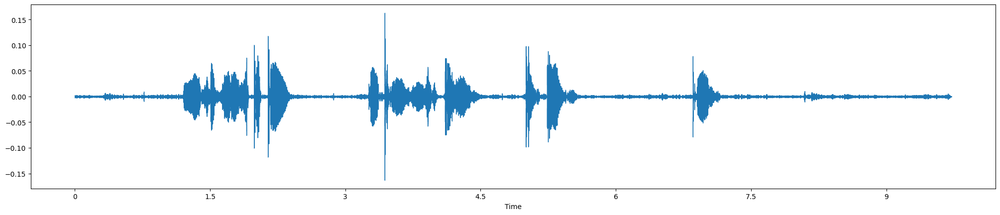

Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


Transcripción para seg_17Tecol_Botan_mowih.wav:
 {'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს', 'chunks': [{'timestamp': (0.0, None), 'text': ' სსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსსს'}]}


In [ ]:
## audios 60-65
procesar_todos_audios(directorio_entrada, 'TB_N', 61, 66)

audio: [1.0682086e-03 1.1788249e-03 1.2381022e-03 ... 1.9379535e-04 4.8595635e-04
 3.7816160e-05],
sampling_rate: 22050


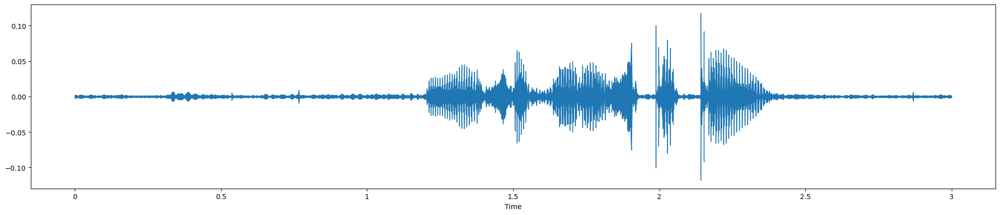

Transcripción para seg_17.1Tecol_Botan_mowih.wav:
 {'text': ' No me saboreste que...', 'chunks': [{'timestamp': (0.0, 4.0), 'text': ' No me saboreste que...'}]}
audio: [ 4.5012624e-04  3.3812248e-04  9.1114809e-05 ...  1.8203604e-06
 -1.8547205e-05 -1.9137360e-06],
sampling_rate: 22050


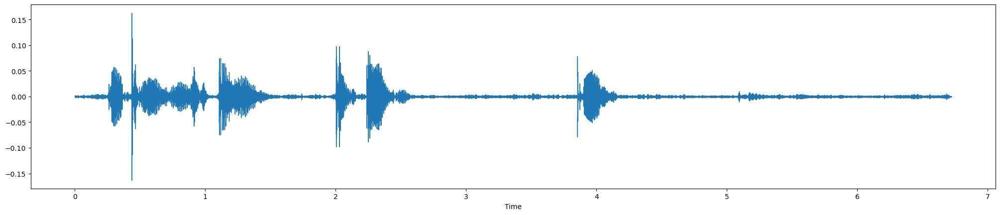

Transcripción para seg_17.2Tecol_Botan_mowih.wav:
 {'text': ' Barte man, ma sotin, ta pulna. Kaya man.', 'chunks': [{'timestamp': (0.0, 4.0), 'text': ' Barte man, ma sotin, ta pulna.'}, {'timestamp': (5.0, 6.0), 'text': ' Kaya man.'}]}


In [ ]:
## audios 65-70
procesar_todos_audios(directorio_entrada, 'TB_N', 66, 71)

# TRANSCRIPCIONES LITERALES A .CSV

### TECOL BOTAN

In [ ]:

directorio_entrada = "/content/drive/MyDrive/Pruebas_Nahuatl/Audios cortados/Tecol_Botan_mowih_seg"


In [ ]:
### archivo 0.1 al 0.4
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',1, 5)



/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:480: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(


Transcripción para seg_0.1Tecol_Botan_mowih.wav:
  Тки шмат търне моли.
Transcripción para seg_0.2Tecol_Botan_mowih.wav:
  Es ist......nicht mehr geschmattet. Aber...
Transcripción para seg_0.3Tecol_Botan_mowih.wav:
  Okay. Can you see?
Transcripción para seg_0.4Tecol_Botan_mowih.wav:
  Es teimāju, viņš picaug. Hēma.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivo 1.1 al 1.6
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',6 , 12)


Transcripción para seg_1.1Tecol_Botan_mowih.wav:
  Honest to none.
Transcripción para seg_1.2Tecol_Botan_mowih.wav:
  See you in the next one.
Transcripción para seg_1.3Tecol_Botan_mowih.wav:
  Wuskupangka kimi se mitru wadaku Juan
Transcripción para seg_1.4Tecol_Botan_mowih.wav:
  So, to... May the just to to...
Transcripción para seg_1.5Tecol_Botan_mowih.wav:
 手に召喚してますので、すまんごうえ。ぽけえ。
Transcripción para seg_1.6Tecol_Botan_mowih.wav:
  se te va el amor
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivo 2
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',12 , 13)


Transcripción para seg_2Tecol_Botan_mowih.wav:
  y que no se hagan cosas que no pueden hacer para los pueblos de la iglesia. Y que se ha servido para que los que están en el mundo puedan ver los pueblos con ellos.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 3.1 al 3.4
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',14 , 18)


Transcripción para seg_3.1Tecol_Botan_mowih.wav:
  ḍo nō lēste tibitsenikokin konchallániya, parámo este kingu néxon.
Transcripción para seg_3.2Tecol_Botan_mowih.wav:
  Google Assistant.
Transcripción para seg_3.3Tecol_Botan_mowih.wav:
  de que le ande a un este......los escolatinas de que le ha...
Transcripción para seg_3.4Tecol_Botan_mowih.wav:
  Emma, stay cool and stay good to me.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 4.1 al 4.2
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',19 , 21)


Transcripción para seg_4.1Tecol_Botan_mowih.wav:
  E que te mo parte ándese, bonte en cuanto á monga e a estón.
Transcripción para seg_4.2Tecol_Botan_mowih.wav:
  Néhi ntigilá ndéhwá npáhwtí ndéhín, néhé tzímané xtíx tukyénguk. Hulé ma, tóhé xté yó ndéhwá né tigpíá numbuné kumbanó. Nukáfé ndát.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivo 5
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',21 , 22)


Transcripción para seg_5Tecol_Botan_mowih.wav:
  Tukakne hun. Chufu tseni. Morki amo ama tikma aschiwa puku nilineke. Serviro para sike molo ndiya nimbunen na tsi mokoliseta ama yunamo ne. Ama tehi piyaste menenu niyondei
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 6.1 al 6.3
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',23 , 26)



Transcripción para seg_6.1Tecol_Botan_mowih.wav:
  hasta una bolita de pizza para...
Transcripción para seg_6.2Tecol_Botan_mowih.wav:
  Teshawa kukulis posmi shchipawa. Ama, te wanubo nebusna li. Asatewa inti wawikia kulika sema. Tia amo.
Transcripción para seg_6.3Tecol_Botan_mowih.wav:
  A mí me gusta que te hagas esto, que te hagas esto.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 7.1 al 7.2
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',27 , 29)



Transcripción para seg_7.1Tecol_Botan_mowih.wav:
  Te pases, te gualentemos, te que piaces, te aprovecho, prean, dejone.
Transcripción para seg_7.2Tecol_Botan_mowih.wav:
  ḍík'i ts'a se t'i se k'un se k'umit in b'ot pandalia se ru'yitu se ki te k'iti w'a se pandalia a b'ez'a s'ta k'i me iw'un t'i k'awa ma'a k'uli sewi apare k'o se ma'a t'i se
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 8.1 al 8.4
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',30 , 34)



Transcripción para seg_8.1Tecol_Botan_mowih.wav:
  E nós estamos partindo de um bíblico que não é meu, que é o que nasce, o que nasce. Eu não me lembro de nada.
Transcripción para seg_8.2Tecol_Botan_mowih.wav:
  Jumku v cím, božeš ty!
Transcripción para seg_8.3Tecol_Botan_mowih.wav:
  Samadeservīru par desavu grupi, pizaktsīci. Jā, nē.
Transcripción para seg_8.4Tecol_Botan_mowih.wav:
  Mas se o Nenegishima e o Peholinca não tiverem um partido...
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 9.1 al 9.4
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',35 , 39)



Transcripción para seg_9.1Tecol_Botan_mowih.wav:
  Come on, good to my dad.
Transcripción para seg_9.2Tecol_Botan_mowih.wav:
  Awez tiki tzendi seitai Wasi ambi yawanochi patitai
Transcripción para seg_9.3Tecol_Botan_mowih.wav:
  Aber, nur dir ist mir das der Junge, der schien war.
Transcripción para seg_9.4Tecol_Botan_mowih.wav:
  Não te estipa, ou se me......neste......posso me confundir em você, mas te cago em ti, ou assim não que......não é igual que me...
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivo 10
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',39 , 40)



Transcripción para seg_10Tecol_Botan_mowih.wav:
  kwa kwa lasiwit, diktamota saliya, morki noa este muna vayo tiaumba. Yuna mguni kisi mmasaikitoka, sinukisi yuustamota sahuwan, muna vayo tiaumba seba saliya. Hema. Yuna mawisimi este pospati paratehwa. Uziyanani kishmatukwa kidikpiyama ada.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 11.1 al 11.2
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',41 , 43)



Transcripción para seg_11.1Tecol_Botan_mowih.wav:
  En......vän......snö och junin.
Transcripción para seg_11.2Tecol_Botan_mowih.wav:
  Mwadida nikpeyombla diida para bibi tsi tsi. Mii meke yuwe kisa tegitus. Mwadikini mwaka busnikin dingi na yuwe gulia. Kema nikindegi liya seru iti mwaka. Okimeki mwatu ke busni lipaati nikpeyobus nej.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 12.1 al 12.3
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',44 , 47)



Transcripción para seg_12.1Tecol_Botan_mowih.wav:
  E ci cuo' il metino, eh, ma ne e' vo' io, n'este, e c'at' e' mu' la nozza e' i ratito.
Transcripción para seg_12.2Tecol_Botan_mowih.wav:
  Оганът ще таменувак. Боя е снегник, вижхват и е по света маса. Света маса, юночи па сте...
Transcripción para seg_12.3Tecol_Botan_mowih.wav:
  y no me pude seguir con esto. Me maté.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 13.1 al 13.3
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',48 , 51)



Transcripción para seg_13.1Tecol_Botan_mowih.wav:
  uz neņu oni gētāk, ka šāna lieskīv, ka tās, ka kūpcīt, no mēs mēs jau brav.
Transcripción para seg_13.2Tecol_Botan_mowih.wav:
  Sejidjikon enigis matikacjivayon i tzijos. Ni kwa kinkan man. Kwa tukpeasipa.
Transcripción para seg_13.3Tecol_Botan_mowih.wav:
  Yeah, man. Wasikine kawokunikaiin.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 14.1 al 14.2
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',52 , 54)


Transcripción para seg_14.1Tecol_Botan_mowih.wav:
  Kā jāstie, akā šī logu, zēdāt cību, ikko esi spesjārnējā.
Transcripción para seg_14.2Tecol_Botan_mowih.wav:
  Iko ki nechi ngariwariwuli se ru ya yu se ro yu. Giji chiva iste kimona koltzi. Wangu jiji chiva ki talye deshne ni fraskus. Wangu namaka kiyanbu.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 15.1 al 15.4
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',55 , 59)



Transcripción para seg_15.1Tecol_Botan_mowih.wav:
  Šādi kīšmatas, vēl vāmonā, kā kā kīšmaties, nezēdāt cīkatīkīti. Neku, mūsim ir pārti, nu. Ema.
Transcripción para seg_15.2Tecol_Botan_mowih.wav:
  Você é que não é.
Transcripción para seg_15.3Tecol_Botan_mowih.wav:
  y me he hecho el yoga pues... yo no me dejo de creer todo así
Transcripción para seg_15.4Tecol_Botan_mowih.wav:
  Cuate para correr por campo Y para especial este...
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 16.1 al 16.5
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',60 , 65)



Transcripción para seg_16.1Tecol_Botan_mowih.wav:
  y la medicina. Bueno, pues como nochanen, y como ustedes, chile motoga, vamos a hablar.
Transcripción para seg_16.2Tecol_Botan_mowih.wav:
  Oh, yes.
Transcripción para seg_16.3Tecol_Botan_mowih.wav:
  n'este nemano ce fili bè rtornat f rsariu
Transcripción para seg_16.4Tecol_Botan_mowih.wav:
  Нивој царникане сте тако сте пеју.
Transcripción para seg_16.5Tecol_Botan_mowih.wav:
  I'm......stay...
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


In [ ]:
### archivos 17.1 al 17.2
procesar_todos_audios_CSV(directorio_entrada, 'TB_N', 'TECOL_BOTAN_N_W',66 , 68)



Transcripción para seg_17.1Tecol_Botan_mowih.wav:
  No me saboreste que...
Transcripción para seg_17.2Tecol_Botan_mowih.wav:
  Barte man, ma sotin, ta pulna. Kaya man.
Transcripciones guardadas en /content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv


# ALLOSAURUS .CSV

In [ ]:
import os
import csv

## para agregar manualmente los fonemas xd :C

def actualizar_fila_csv(cadena_fonemas, fila):
    # Ruta del archivo CSV
    ruta_csv = '/content/drive/MyDrive/allosaurus/TECOL_BOTAN_allosaurus.csv'

    # Verificar si el archivo existe
    archivo_existe = os.path.isfile(ruta_csv)

    # Leer todas las filas existentes en el archivo CSV si ya existe
    filas = []
    if archivo_existe:
        with open(ruta_csv, mode='r', newline='') as file:
            reader = csv.reader(file)
            filas = list(reader)

    # Si el archivo no existe, agregar el encabezado
    if not archivo_existe:
        filas.append(['Fonemas'])

    # Asegurar que la lista tiene suficientes filas
    while len(filas) < fila:
        filas.append([None])

    # Actualizar la fila especificada con la cadena de fonemas
    filas[fila - 1] = [cadena_fonemas]

    # Escribir las filas actualizadas de nuevo en el archivo CSV
    with open(ruta_csv, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerows(filas)


In [ ]:
a=model.recognize('/content/drive/MyDrive/Pruebas_Nahuatl/Audios cortados/Tecol_Botan_mowih_seg/seg_17.2Tecol_Botan_mowih.wav')
a

'b ʌ l̪ t ɨ m ɒ n ɒ l̪ s ɛ pʲ j i j iː ɴ ʌ t̪ o z ɴ k͡p̚ ɯ a'

In [ ]:
# Cadena de fonemas
cadena_fonemas = a
# Llamar a la función para actualizar el archivo CSV
actualizar_fila_csv(cadena_fonemas, 54)

# ALINEACIÓN

In [ ]:
## FUNCION PARA ALINEAR Y PASAR LAS ALINEACIONES DE PALABRAS CON FONEMAS A UN .CSV
import csv
import os

def obtener_valores_desde_csv(archivo, columna, inicio, fin):
    valores = []
    with open(archivo, newline='') as csvfile:
        reader = csv.reader(csvfile)
        for i, row in enumerate(reader):
            if i >= inicio and i < fin:
                valores.append(row[columna])
    return valores

def segment_fonemas(archivo_1, archivo_2, init_1, fin_1, init_2, fin_2, output_directory):
    # Verificar y crear el directorio si no existe
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)

    # Ruta completa del archivo de salida
    output_file = os.path.join(output_directory, "TECOL_BOTAN_aln.csv")  ###nombre del archivo

    # Obtener las filas correspondientes de ambos archivos
    fonemas_str_list = obtener_valores_desde_csv(archivo_1, 0, init_1, fin_1)
    transcripcion_list = obtener_valores_desde_csv(archivo_2, 1, init_2, fin_2)

    # Verificar que las listas tengan el mismo número de elementos
    if len(fonemas_str_list) != len(transcripcion_list):
        raise ValueError("Los rangos de filas especificados deben tener la misma longitud")

    # Crear una lista para guardar los resultados
    resultados = []

    # Procesar cada par de filas
    for fonemas_str, transcripcion in zip(fonemas_str_list, transcripcion_list):
        # Convertir la cadena de fonemas en una lista
        fonemas = fonemas_str.split()

        # Dividir la transcripción en palabras
        palabras = transcripcion.split()

        # Variables para el resultado y el índice actual de fonemas
        idx_fonema = 0

        for palabra in palabras:
            # Determinar la longitud estimada de la palabra en fonemas
            # Suponiendo que cada letra corresponde a un fonema
            longitud_palabra = len(palabra)

            # Encontrar el conjunto de fonemas correspondiente a la palabra
            palabra_fonemas = []
            while len(palabra_fonemas) < longitud_palabra and idx_fonema < len(fonemas):
                palabra_fonemas.append(fonemas[idx_fonema])
                idx_fonema += 1

            # Agregar la palabra y sus fonemas al resultado
            resultados.append((palabra, ' '.join(palabra_fonemas)))

    # Guardar los resultados en un archivo CSV
    with open(output_file, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['Palabra', 'Fonemas'])  # Escribir la cabecera
        for palabra, fonemas in resultados:
            writer.writerow([palabra, fonemas])

    print(f"Resultados guardados en {output_file}")


In [ ]:
# EJECUTAMOS PARA CADA ARCHIVO
archivo_1 = "/content/drive/MyDrive/allosaurus/TECOL_BOTAN_allosaurus.csv"  ## aqui los fonemas
archivo_2 = "/content/drive/MyDrive/Whisperr/TECOL_BOTAN_N_W.csv"  ## aqui poner el whisper
init_1 = 1
fin_1 = 54
init_2 = 1
fin_2 = 54
output_directory = "/content/drive/MyDrive/Alineaciones"

segment_fonemas(archivo_1, archivo_2, init_1, fin_1, init_2, fin_2, output_directory)

Resultados guardados en /content/drive/MyDrive/Alineaciones/TECOL_BOTAN_aln.csv
